# Importing Libraries & Datasets

In [1]:
import warnings
warnings.filterwarnings('ignore')
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

import pandas as pd
import numpy as np
import pandas_profiling
from datetime import datetime
import os
import string
import re
import missingno as msno

import nltk
from nltk.stem.porter import PorterStemmer
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize

import scipy
from scipy import sparse
from scipy.sparse import hstack
from scipy.cluster import hierarchy as hc

from sklearn import preprocessing
from sklearn.preprocessing import OrdinalEncoder

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split

from sklearn.model_selection import GridSearchCV

from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import SGDClassifier

from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier

from sklearn.multioutput import ClassifierChain
from sklearn.multioutput import MultiOutputClassifier

from sklearn.metrics import accuracy_score
from sklearn.metrics import recall_score
from sklearn.metrics import precision_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import f1_score

import matplotlib
import matplotlib.pyplot as plt
from wordcloud import WordCloud
import seaborn as sns
sns.set_style('dark')
%matplotlib inline
import matplotlib.ticker as ticker

from sklearn.metrics import precision_recall_curve
from sklearn.metrics import average_precision_score
#sklearn.model_selection
porter_stemmer = PorterStemmer()
wordnet_lemmatizer = WordNetLemmatizer()

# Read Datasets, Processing & EDA

## Read Training & Test Datasets

In [2]:
auto_ind = pd.read_csv('train/automobile_industry.csv')
comp_ind = pd.read_csv('train/computer_industry.csv')
health_ind = pd.read_csv('train/health_industry.csv')
manu_ind = pd.read_csv('train/manufacturing_industry.csv')
power_ind = pd.read_csv('train/power_industry.csv')

test = pd.read_csv('test/test.csv')
#Add Industry Identifier
auto_ind['Industry']='Automobile'
comp_ind['Industry']='Computer'
health_ind['Industry']='Health'
manu_ind['Industry']='Manufacturing'
power_ind['Industry']='Power'
auto_ind['Start_date'] = pd.to_datetime(auto_ind['Start_date'], format='%B,%Y')
comp_ind['Start_date'] = pd.to_datetime(comp_ind['Start_date'], format='%B,%Y')
health_ind['Start_date'] = pd.to_datetime(health_ind['Start_date'], format='%B,%Y')
manu_ind['Start_date'] = pd.to_datetime(manu_ind['Start_date'], format='%B,%Y')
power_ind['Start_date'] = pd.to_datetime(power_ind['Start_date'], format='%B,%Y')
test['Start_date'] = pd.to_datetime(test['Start_date'], format='%B,%Y')

## Read Product Info

In [3]:
arr = os.listdir('train/product_info')
all_product_info = pd.DataFrame()
test_all_product_info = pd.DataFrame()
strtxt = ".txt"
for txtfile in arr:
    if txtfile.__contains__(strtxt):
        file_add = str('train/product_info/')+str(txtfile)
        fileObject = open(file_add, "r", encoding="unicode_escape")
        data = fileObject.read()
        product_info_data = pd.DataFrame([[txtfile.replace(strtxt,'') ,data]],columns = ['ID','product_info'])
        all_product_info = all_product_info.append(product_info_data)

arr = os.listdir('test/product_info')
strtxt = ".txt"
for txtfile in arr:
    if txtfile.__contains__(strtxt):
        file_add = str('test/product_info/')+str(txtfile)
        fileObject = open(file_add, "r", encoding="unicode_escape")
        data = fileObject.read()
        product_info_data = pd.DataFrame([[txtfile.replace(strtxt,'') ,data]],columns = ['ID','product_info'])
        test_all_product_info = test_all_product_info.append(product_info_data)
        
# Merge Product Info with Training Data
auto_ind = auto_ind.merge(all_product_info, on='ID', how='left')
comp_ind = comp_ind.merge(all_product_info, on='ID', how='left')
health_ind = health_ind.merge(all_product_info, on='ID', how='left')
manu_ind = manu_ind.merge(all_product_info, on='ID', how='left')
power_ind = power_ind.merge(all_product_info, on='ID', how='left')
test = test.merge(test_all_product_info, on = 'ID')
eda_input_df = pd.concat([auto_ind,comp_ind,health_ind,manu_ind,power_ind])

# Exploratory Data Analysis & Data Processing

###### Automobile Datasets Contain Many Missing and Unknown Values
###### Coulmns- 'Symbol', 'CEO', 'Country' have high cardinality 
###### Automobile Industry has 6 products across 3 categories
###### Company Background & Product Info has textual data and can be processed to created meaningful features

In [4]:
eda_input_df.describe(include='all').transpose()

,count,unique,top,freq,first,last,mean,std,min,25%,50%,75%,max
ID,23909,23909,PROJ0x5377,1,NaT,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Symbol,6545,5947,KOW,4,NaT,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Start_date,8811,780,2002-11-01 00:00:00,22,1950-01-01,2014-12-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN
market_cap,23872,4,?,12055,NaT,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Sector,20983,3,?,9341,NaT,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Country,3610,231,Dominican Republic,32,NaT,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CEO,23882,8570,?,15213,NaT,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
No.of employee,9564.0,NaN,NaN,NaN,NaT,NaT,24893.030217,21818.740348,1.0,6928.75,18509.0,38382.0,97590.0
Revenue (Cr),23863,14472,-999.0,5051,NaT,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Net-valuation (Cr),15896.0,NaN,NaN,NaN,NaT,NaT,1998.416353,13769.866535,-91524.892623,188.801514,1101.247801,4404.665252,83237.474347


In [5]:
pandas_profiling.ProfileReport(eda_input_df)

Summarize dataset:   0%|          | 0/30 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Analyze Y variables

##### We observe same products across different industries e.g. Bike (Automobile & Manufacturing), AI ( Automobile & Computer) 
##### Just One Record with 'Heavy vehicle' for product Truck which can be replace with Heavy Vehicles
##### Similarly Type has null values, they can be computed using Industry & Product, So Assign Type as where that product and industry has most records wherever  Type is Null 

In [6]:
eda_input_df[['Industry','Type','Product']].isnull().any()

Industry    False
Type         True
Product     False
dtype: bool

In [7]:
y_combinations = pd.DataFrame({'Row Count': eda_input_df.groupby(['Industry','Type','Product'])['ID'].count()}).reset_index()
y_combinations.sort_values(['Industry','Type','Product'])

,Industry,Type,Product,Row Count
0,Automobile,Heavy Vehicles,JCP,793
1,Automobile,Heavy Vehicles,None,8
2,Automobile,Heavy Vehicles,Truck,784
3,Automobile,Heavy vehicle,Truck,1
4,Automobile,Light Vehicles,AI,797
5,Automobile,Light Vehicles,Bike,879
6,Automobile,Light Vehicles,Car,756
7,Automobile,Light Vehicles,None,5
8,Automobile,Light Vehicles,Truck,768
9,Computer,Hardware,AI,495


## Handle Nulls and Missing Values,Clean & Define - Dependent & Independent variables

In [8]:
id_columns = ['ID']
x_columns = ['Company_background']
y_columns = ['Industry','Type','Product']
def fix_type(df):
    df = df.replace('?','')
    df['Type'] = df['Type'].str.replace('vehicle','Vehicles')
    y_combs = df[y_columns].drop_duplicates()
    y_combs['y_identifier']=np.arange(0,len(y_combs))
    df = df.merge(y_combs, on = y_columns,how='inner')
    y_combs = y_combs[y_combs['Type'].isnull()]
    y_dist = pd.DataFrame({'row_count': df.groupby(y_columns)['Company_background'].count()}).reset_index()
    y_dist = y_dist.groupby(['Industry','Product'])['Type'].max().reset_index()
    y_combs = y_combs.drop('Type',axis=1)
    imputed_type_combination = y_combs.merge(y_dist, on = ['Product','Industry'],how='inner').reset_index(drop = True)
    imputed_type_combination = imputed_type_combination.rename(columns = {'Type':'New Type'})
    imputed_type_combination = imputed_type_combination.drop(['Industry','Product'],axis=1)
    df = df.merge(imputed_type_combination, on ='y_identifier',how='left')
    df['Type'] = np.where(df['Type'].isnull(),df['New Type'],df['Type'])
    df = df.drop('New Type',axis = 1)
    return df

def clean_x_variables(input_df):
    id = input_df['ID']
    input_df['id_len']=input_df['ID'].str.len()
    input_df['Symbol'] = input_df['Symbol'].fillna('symbol_not_available')
    input_df['market_cap'] = input_df['market_cap'].fillna('market_cap_not_available')
    input_df['Sector'] = input_df['Sector'].fillna('sector_not_available')
    input_df['Country'] = input_df['Country'].fillna('country_not_available')
    input_df['CEO'] = input_df['CEO'].fillna('CEO Not Available')
    input_df['No.of employee']=np.where(input_df['No.of employee'].isnull(),0,input_df['No.of employee'])
    input_df['Revenue (Cr)']=np.where(input_df['Revenue (Cr)'].isnull(),0,input_df['Revenue (Cr)'])
    input_df['Net-valuation (Cr)']=np.where(input_df['Net-valuation (Cr)'].isnull(),0,input_df['Net-valuation (Cr)'])
    input_df['Share_price (RS)']=np.where(input_df['Share_price (RS)'].isnull(),0,input_df['Share_price (RS)'])
    return input_df
    
def create_vars(df):
    df_market_cap_encoded = pd.get_dummies(df['market_cap'],prefix = 'market_cap',drop_first=True)   
    df_sector_encoded = pd.get_dummies(df['Sector'],prefix = 'sector')
    one_hot_vars = pd.concat([df_market_cap_encoded,df_sector_encoded],axis = 1)
    cat_vars = df[['Symbol','Country','CEO']]
    oe = OrdinalEncoder()
    oe.fit(cat_vars)
    cat_vars_encoded = oe.transform((cat_vars))
    other_cat_vars = np.concatenate((cat_vars_encoded,np.array(one_hot_vars)),axis=1)
    continous_vars = df[['Revenue (Cr)','No.of employee','Net-valuation (Cr)','Share_price (RS)']]
    continous_vars['Revenue (Cr)'] = continous_vars['Revenue (Cr)'].replace('',0)
    
    normalized_arr = preprocessing.normalize(continous_vars)
    all_vars = np.concatenate((other_cat_vars,normalized_arr),axis = 1)
    all_vars_sparse = sparse.csr_matrix(all_vars,shape= all_vars.shape)
    market_cap_columns = np.array(df_market_cap_encoded.columns)
    Sector_columns = np.array(df_sector_encoded.columns)
    remaining_var_columns = np.array(['Symbol','Country','CEO','Revenue (Cr)','No.of employee','Net-valuation (Cr)','Share_price (RS)'])
    encoded_columns = np.concatenate((market_cap_columns,Sector_columns),axis=0)
    all_columns = np.concatenate((encoded_columns,remaining_var_columns),axis=0)
    return all_vars_sparse, all_columns
                                           
auto_ind_imp_type = fix_type(auto_ind)
comp_ind_imp_type = fix_type(comp_ind)
health_ind_imp_type = fix_type(health_ind)
manu_ind_imp_type = fix_type(manu_ind)
power_ind_imp_type = fix_type(power_ind)
test = test.replace('?','')
input_df = eda_input_df
input_df = fix_type(input_df)
input_df = clean_x_variables(input_df)
test = clean_x_variables(test)
train_x_sparse, train_column_list = create_vars(input_df)
test_x_sparse, test_column_list = create_vars(test)

## Create Functions For NLP of Textual Columns, Feature Cleaning & Engineering

In [9]:
porter = PorterStemmer()
table = str.maketrans('', '', string.punctuation)
lemmatizer = WordNetLemmatizer()
stop_words = set(stopwords.words('english'))

#define NLP Functions
def cleantext(val):
    val = str(val).replace(r'[^\x00-\x7F]+', '')
    if len(val.split()) >=2:
        val = val.lower()
        tk = word_tokenize(val)
        #tk = [porter.stem(word) for word in tk]
        #tk = [lemmatizer.lemmatize(word) for word in tk]
        #tk = [w.translate(table) for w in tk]
        tk = [word for word in tk if word.isalpha()]
        tk = [w for w in tk if not w in stop_words]
        return ' '.join(tk)
    else:
        return 'Not Avaiable'

def preprocess_dataframe(input_df,x_columns,y_columns=None):

    if(y_columns==None):
        df = input_df.drop(x_columns,axis=1) 
    else:
        df = input_df.reindex(columns = y_columns)
    
    df['text'] = input_df[x_columns].apply(lambda x: ' '.join(x.map(str)), axis=1)
    df['text']= df['text'].apply(lambda x: x.lower())
    df['clean'] = df['text'].apply(cleantext)
    df = df.dropna(axis=0, subset=['clean'])

    df['ID'] = input_df['ID']
    return df

x_columns = ['Company_background']
auto_processed = preprocess_dataframe(auto_ind_imp_type,x_columns,y_columns)
comp_processed = preprocess_dataframe(comp_ind_imp_type,x_columns,y_columns)
health_processed = preprocess_dataframe(health_ind_imp_type,x_columns,y_columns)
manu_processed = preprocess_dataframe(manu_ind_imp_type,x_columns,y_columns)
power_processed = preprocess_dataframe(power_ind_imp_type,x_columns,y_columns)
input_df_processed_background = pd.concat([auto_processed,comp_processed,health_processed,manu_processed,power_processed])
test_processed_background = preprocess_dataframe(test,x_columns)
x_columns = ['product_info']
input_df_processed_prd_info = preprocess_dataframe(input_df,x_columns,y_columns)
test_processed_prd_info = preprocess_dataframe(test,x_columns)
input_df_processed_prd_info = input_df_processed_prd_info.rename(columns={'clean':'product_info'})
input_df_processed_background = input_df_processed_background.rename(columns={'clean':'Company_background'})
input_df_processed = input_df_processed_prd_info.merge(input_df_processed_background[['ID','Company_background']], on ='ID')

In [10]:
# Create Distinct Words Dictionary at Industry, Industry & Type, Industry & Type & Product Level -Yet to complete
def create_word_industry_feature_mapp(df,var,n_range):
    vectorizer = TfidfVectorizer(min_df=2,ngram_range = (1,n_range),lowercase = True) #ngram_range=(1,2)
    distinct_vars = list(df[var].drop_duplicates())
    j=0
    
    for i in distinct_vars:
        df_name = 'df'+'_'+i
        new_col_name = str(var)+'_'+str(i)
        globals()[df_name] = df[df[var]==i]
        vectorizer.fit(globals()[df_name]['clean'].apply(lambda x: np.str_(x)))
        globals()[df_name+'_list'] = set(vectorizer.get_feature_names())
        globals()[df_name+'_list_df'] = pd.DataFrame(globals()[df_name+'_list'],columns = ['words'])
        globals()[df_name+'_list_df'][new_col_name] = i
        if(j==0):
            distinct_words =  globals()[df_name+'_list']
        else:
            distinct_words = distinct_words ^ globals()[df_name+'_list']  
        j=j+1
    
    distinct_words_df = pd.DataFrame(distinct_words,columns = ['words'])
    for i in distinct_vars:
        df_name = 'df'+'_'+i
        distinct_words_df = distinct_words_df.merge(globals()[df_name+'_list_df'],on = 'words',how= 'left')
    
    
    distinct_words_df['null_count'] = distinct_words_df.isnull().sum(axis =1)
    if (var == 'Industry'):
        distinct_words_df = distinct_words_df[distinct_words_df['null_count']==4]
        distinct_words_df['Feature'] = np.nan
        distinct_words_df['Feature'] = distinct_words_df['Feature'].fillna(distinct_words_df.iloc[:,1]).fillna(distinct_words_df.iloc[:,2]).fillna(distinct_words_df.iloc[:,3]).fillna(distinct_words_df.iloc[:,4]).fillna(distinct_words_df.iloc[:,5])
        distinct_words_df = distinct_words_df.reindex(columns = ['words','Feature']) 
    elif(var == 'Type'):
        distinct_words_df = distinct_words_df[distinct_words_df['null_count']==11]
        distinct_words_df['Feature'] = np.nan
        distinct_words_df['Feature'] = distinct_words_df['Feature'].fillna(distinct_words_df.iloc[:,1]).fillna(distinct_words_df.iloc[:,2]).fillna(distinct_words_df.iloc[:,3]).fillna(distinct_words_df.iloc[:,4]).fillna(distinct_words_df.iloc[:,5]).fillna(distinct_words_df.iloc[:,6]).fillna(distinct_words_df.iloc[:,7]).fillna(distinct_words_df.iloc[:,8]).fillna(distinct_words_df.iloc[:,9]).fillna(distinct_words_df.iloc[:,10]).fillna(distinct_words_df.iloc[:,11]).fillna(distinct_words_df.iloc[:,12])
        distinct_words_df = distinct_words_df.reindex(columns = ['words','Feature']) 
    elif(var == 'Product'):
        distinct_words_df = distinct_words_df[distinct_words_df['null_count']==24]
        distinct_words_df['Feature'] = np.nan
        distinct_words_df['Feature'] = distinct_words_df['Feature'].fillna(distinct_words_df.iloc[:,1]).fillna(distinct_words_df.iloc[:,2]).fillna(distinct_words_df.iloc[:,3]).fillna(distinct_words_df.iloc[:,4]).fillna(distinct_words_df.iloc[:,5]).fillna(distinct_words_df.iloc[:,6]).fillna(distinct_words_df.iloc[:,7]).fillna(distinct_words_df.iloc[:,8]).fillna(distinct_words_df.iloc[:,9]).fillna(distinct_words_df.iloc[:,10]).fillna(distinct_words_df.iloc[:,11]).fillna(distinct_words_df.iloc[:,12]).fillna(distinct_words_df.iloc[:,13]).fillna(distinct_words_df.iloc[:,14]).fillna(distinct_words_df.iloc[:,15]).fillna(distinct_words_df.iloc[:,16]).fillna(distinct_words_df.iloc[:,17]).fillna(distinct_words_df.iloc[:,18]).fillna(distinct_words_df.iloc[:,19]).fillna(distinct_words_df.iloc[:,20]).fillna(distinct_words_df.iloc[:,21]).fillna(distinct_words_df.iloc[:,22]).fillna(distinct_words_df.iloc[:,23]).fillna(distinct_words_df.iloc[:,24]).fillna(distinct_words_df.iloc[:,25])
        distinct_words_df = distinct_words_df.reindex(columns = ['words','Feature']) 

    return distinct_words_df

def create_vocab(df,n_range):
    industry_word_map = create_word_industry_feature_mapp(input_df_processed,'Industry',n_range)
    #type_word_map = create_word_industry_feature_mapp(input_df_processed,'Type',n_range)
    #product_word_map = create_word_industry_feature_mapp(input_df_processed,'Product',n_range)
    #nlp_vocab = pd.concat([industry_word_map,type_word_map,product_word_map])
    return industry_word_map
#vocab_df = create_vocab(input_df_processed,1)
#vocab = vocab_df.applymap(str.strip).applymap(str.lower).set_index('words').Feature
#vocab_dict = vocab.to_dict()

## Create Function for Getting Top Words at Different Levels of Dependent variables

In [11]:
def display_scores(vectorizer, tfidf_result):
    scores = zip(vectorizer.get_feature_names(),
                 np.asarray(tfidf_result.sum(axis=0)).ravel())
    sorted_scores = sorted(scores, key=lambda x: x[1], reverse=True)
    return sorted_scores

def get_top_words(gdf,level,m,n,column = 'clean'):
    top_words= pd.DataFrame()
    top_gdf = pd.DataFrame()
    english_stop_words = set(stopwords.words('english'))
    for ind in gdf.Industry.unique():
        temp = gdf[gdf['Industry']==ind]
        try:
            tfIdfVectorizer=TfidfVectorizer(use_idf=True, ngram_range=(1,10),stop_words=stop_words)
            tfIdf = tfIdfVectorizer.fit_transform(temp[column].values)
            words=display_scores(tfIdfVectorizer,tfIdf)
            words_df = pd.DataFrame(words,columns = ['word','tfidf_score'])
            words_df = words_df[:m] 
            words_df.loc[:,'Industry'] =ind
            words_df.loc[:,'Type'] = None
            top_words = top_words.append(words_df)
        except:
            pass
    if(level==2):
        for ind in gdf.Industry.unique():
            temp = gdf[gdf['Industry']==ind]
            for typ in gdf.Type.unique():
                temp = gdf[gdf['Type']==typ]
                try:
                    tfIdfVectorizer=TfidfVectorizer(use_idf=True, ngram_range=(1,5),stop_words=stop_words)
                    tfIdf = tfIdfVectorizer.fit_transform(temp[column].values)
                    words=display_scores(tfIdfVectorizer,tfIdf)
                    words_df = pd.DataFrame(words,columns = ['word','tfidf_score'])
                    words_df = words_df[:n] 
                    words_df.loc[:,'Industry'] =ind
                    words_df.loc[:,'Type'] = typ
                    top_words = top_words.append(words_df)
                except:
                    pass
             
    return top_words

## Create Train Validation Splits & Get features from the Training Set

In [12]:
df_train, df_valid = train_test_split(
input_df_processed, test_size=0.3, random_state=250)
bck_top_words = get_top_words(df_train,2,25,10,'Company_background') 
inf_top_words = get_top_words(df_train,2,50,10,'product_info') 

## Create Word Clouds For Analysing Top Features

### Define Word Cloud Function

In [13]:
def create_word_clouds(df,str):
    temp = df[df['Type'].isnull()]
    for i in temp.Industry.unique():
        
        print('Top Words for '+i+ ' Industry From '+str+' Column')
        ind_df = temp[temp['Industry']==i]
        ind_df.index = ind_df.word
        transposed = ind_df.T
        word_cloud = WordCloud(collocations = True, background_color = 'white').generate_from_frequencies(transposed.iloc[1])
        _ = plt.figure(figsize=(10,10))
        _ = plt.imshow(word_cloud, interpolation='bilinear')
        _ = plt.axis("off")
        plt.show()
    
    temp = df[df['Type'].notnull()]
    for i in temp.Industry.unique():
        ind_df = temp[temp['Industry']==i]
        for t in temp.Type.unique():
            ind_df = temp[temp['Type']==t]
            print('Top Words for '+i+ ' Industry and ' + t + ' Type Products From '+str+' Column')
            ind_df.index = ind_df.word
            transposed = ind_df.T
            word_cloud = WordCloud(collocations = True, background_color = 'white').generate_from_frequencies(transposed.iloc[1])
            _ = plt.figure(figsize=(10,10))
            _ = plt.imshow(word_cloud, interpolation='bilinear')
            _ = plt.axis("off")
            plt.show()

### Word Cloud From Company Background

Top Words for Manufacturing Industry From Company Background Column


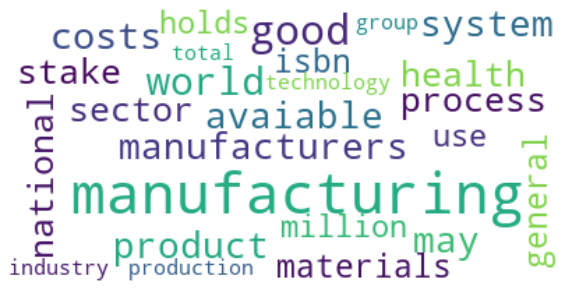

Top Words for Health Industry From Company Background Column


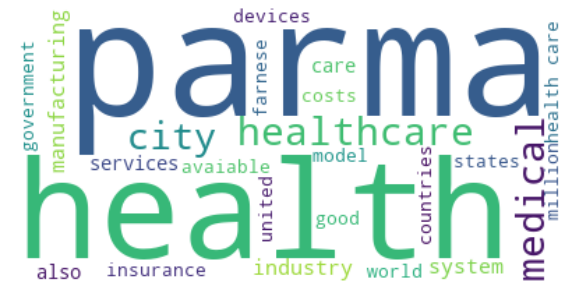

Top Words for Computer Industry From Company Background Column


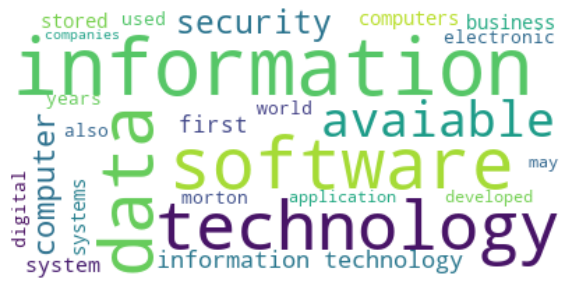

Top Words for Power Industry From Company Background Column


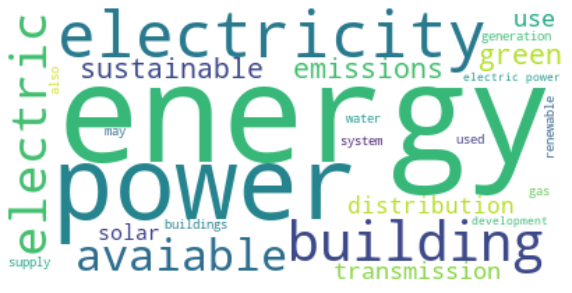

Top Words for Automobile Industry From Company Background Column


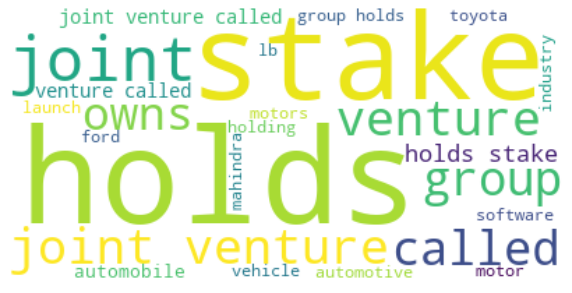

Top Words for Manufacturing Industry and Toys Type Products From Company Background Column


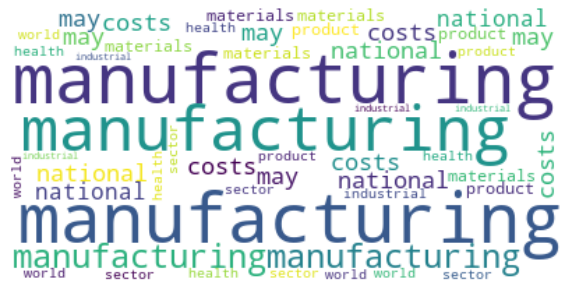

Top Words for Manufacturing Industry and Diagnostic Type Products From Company Background Column


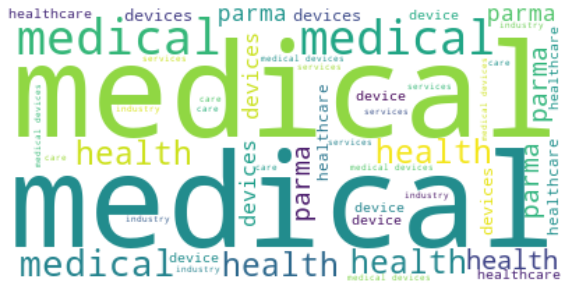

Top Words for Manufacturing Industry and Software Type Products From Company Background Column


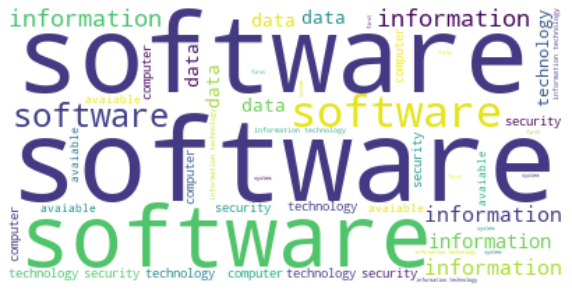

Top Words for Manufacturing Industry and green energy Type Products From Company Background Column


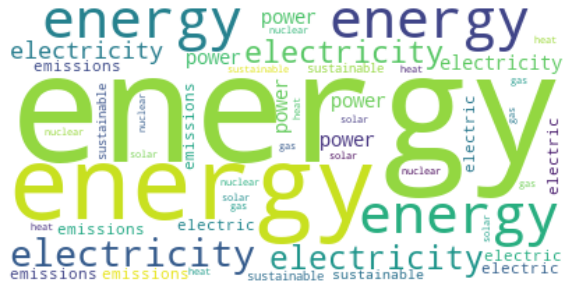

Top Words for Manufacturing Industry and Heavy Vehicles Type Products From Company Background Column


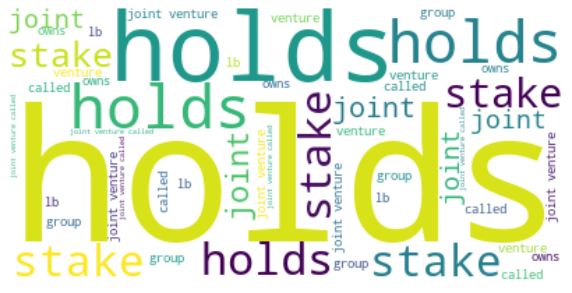

Top Words for Manufacturing Industry and Light Vehicles Type Products From Company Background Column


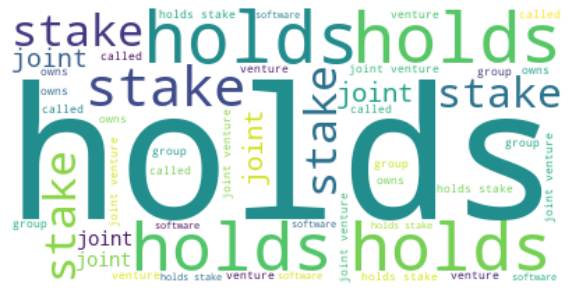

Top Words for Manufacturing Industry and Pharma Type Products From Company Background Column


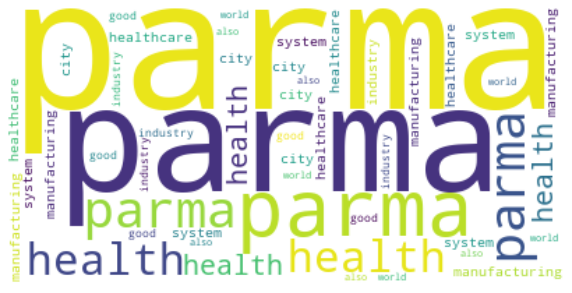

Top Words for Manufacturing Industry and Security Type Products From Company Background Column


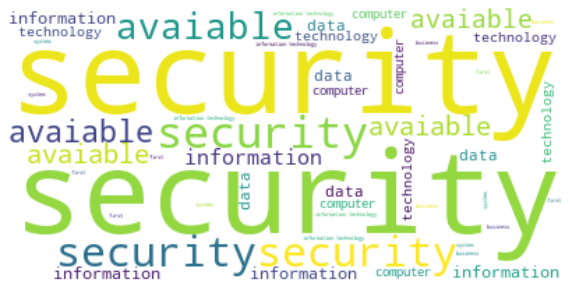

Top Words for Manufacturing Industry and Food Type Products From Company Background Column


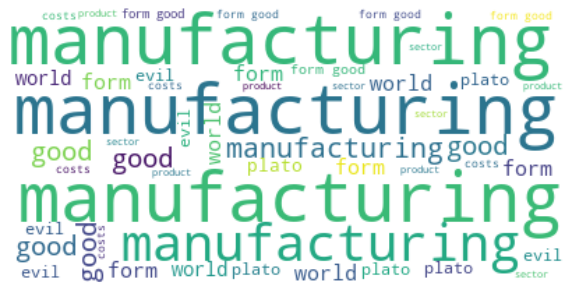

Top Words for Manufacturing Industry and Hardware Type Products From Company Background Column


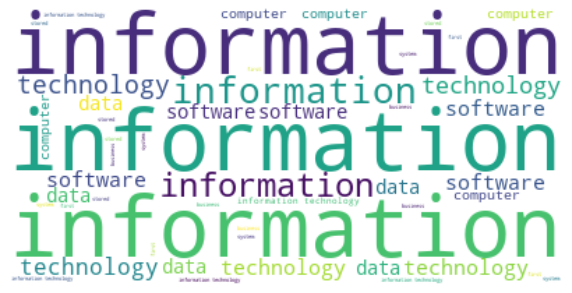

Top Words for Manufacturing Industry and Production Type Products From Company Background Column


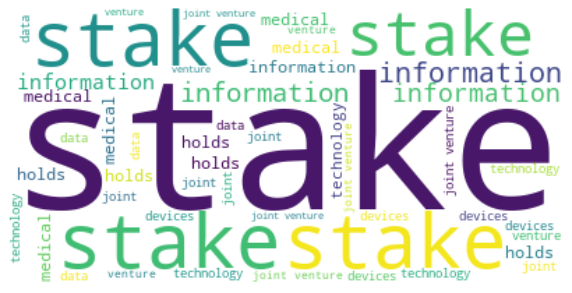

Top Words for Manufacturing Industry and non green energy Type Products From Company Background Column


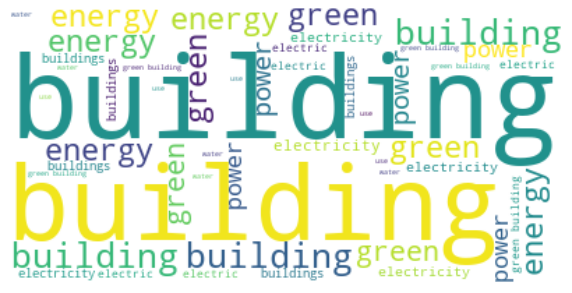

Top Words for Manufacturing Industry and Mechanical Type Products From Company Background Column


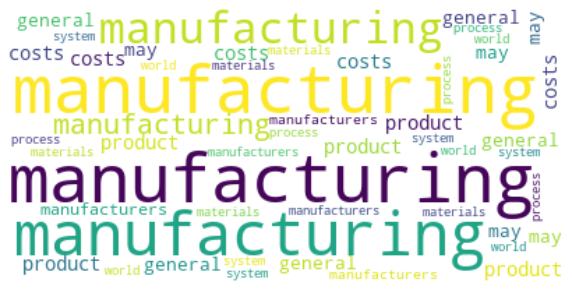

Top Words for Health Industry and Toys Type Products From Company Background Column


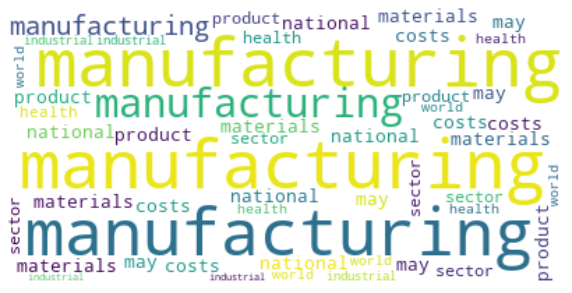

Top Words for Health Industry and Diagnostic Type Products From Company Background Column


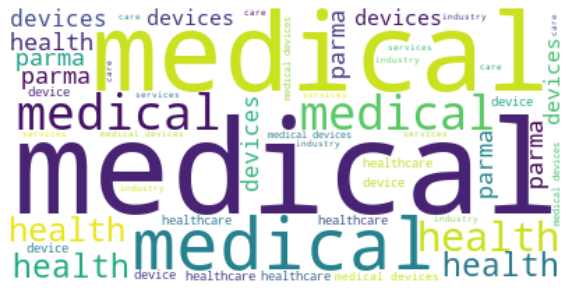

Top Words for Health Industry and Software Type Products From Company Background Column


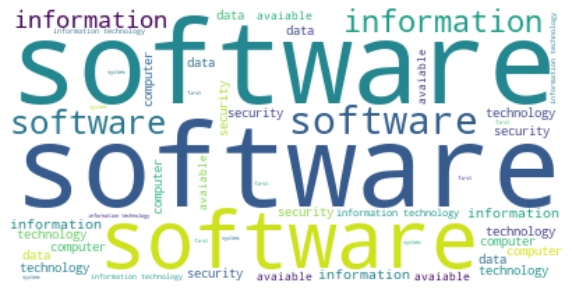

Top Words for Health Industry and green energy Type Products From Company Background Column


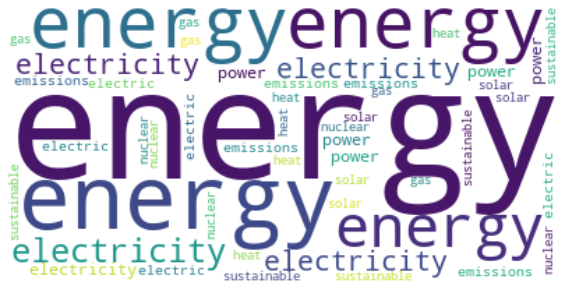

Top Words for Health Industry and Heavy Vehicles Type Products From Company Background Column


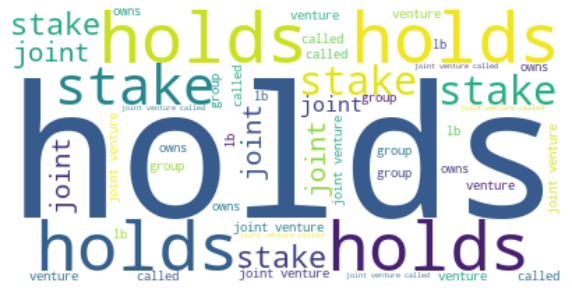

Top Words for Health Industry and Light Vehicles Type Products From Company Background Column


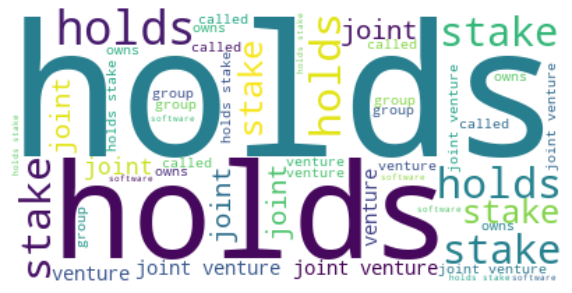

Top Words for Health Industry and Pharma Type Products From Company Background Column


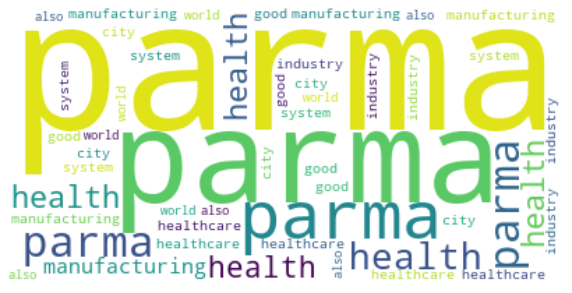

Top Words for Health Industry and Security Type Products From Company Background Column


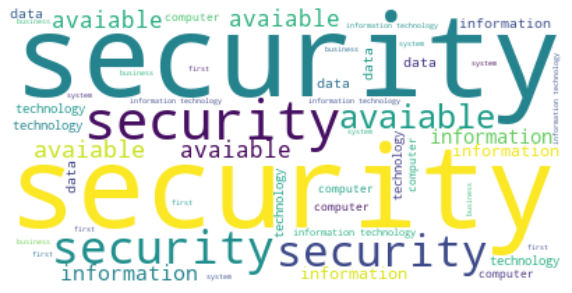

Top Words for Health Industry and Food Type Products From Company Background Column


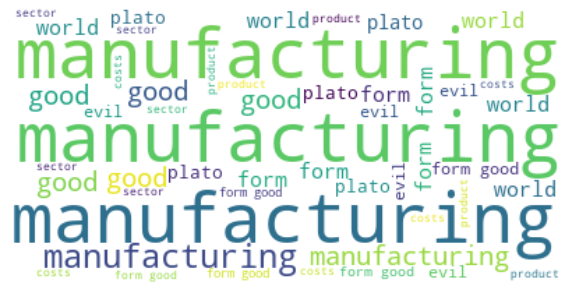

Top Words for Health Industry and Hardware Type Products From Company Background Column


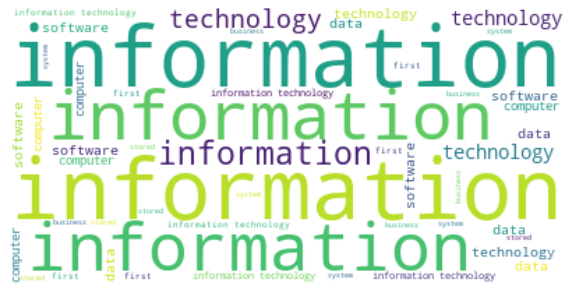

Top Words for Health Industry and Production Type Products From Company Background Column


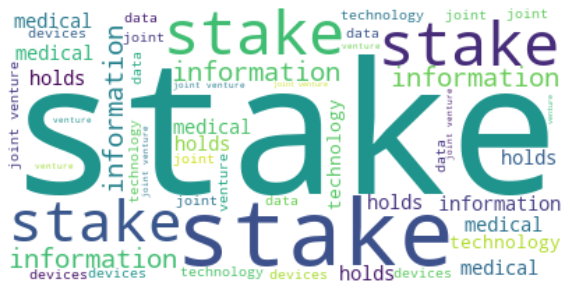

Top Words for Health Industry and non green energy Type Products From Company Background Column


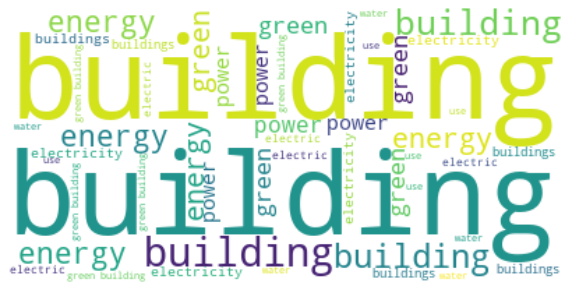

Top Words for Health Industry and Mechanical Type Products From Company Background Column


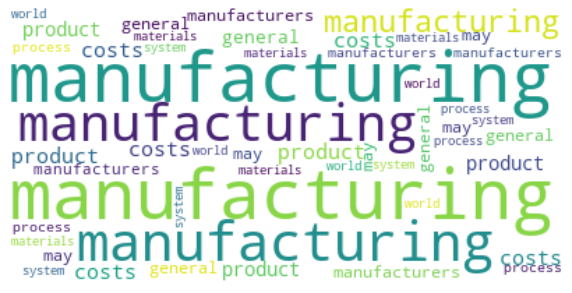

Top Words for Computer Industry and Toys Type Products From Company Background Column


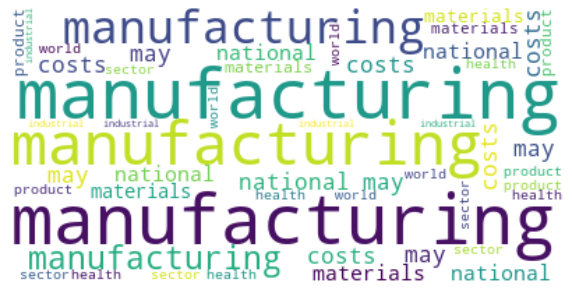

Top Words for Computer Industry and Diagnostic Type Products From Company Background Column


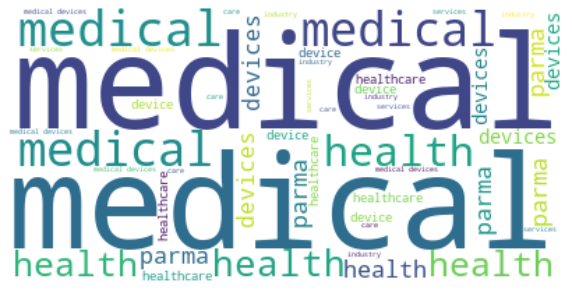

Top Words for Computer Industry and Software Type Products From Company Background Column


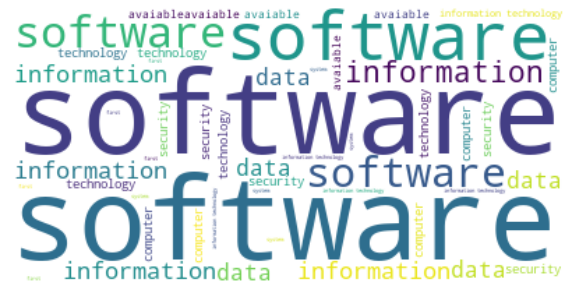

Top Words for Computer Industry and green energy Type Products From Company Background Column


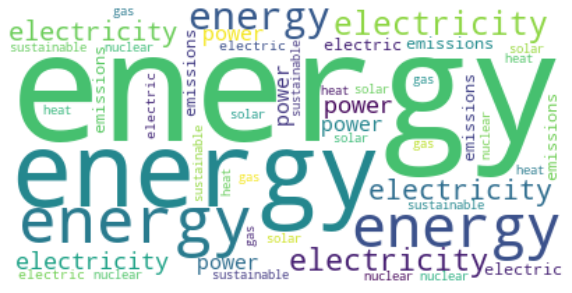

Top Words for Computer Industry and Heavy Vehicles Type Products From Company Background Column


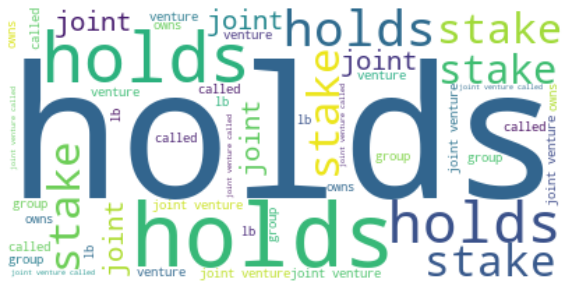

Top Words for Computer Industry and Light Vehicles Type Products From Company Background Column


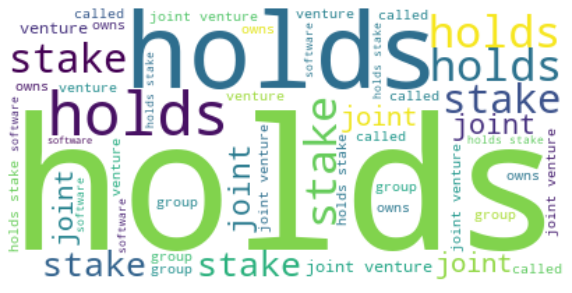

Top Words for Computer Industry and Pharma Type Products From Company Background Column


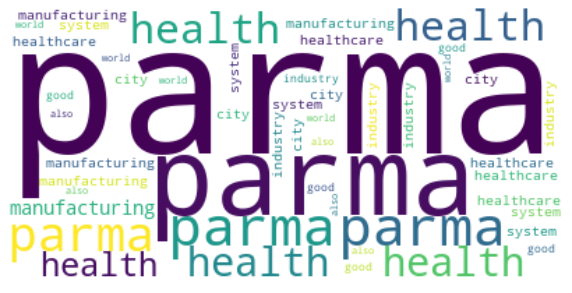

Top Words for Computer Industry and Security Type Products From Company Background Column


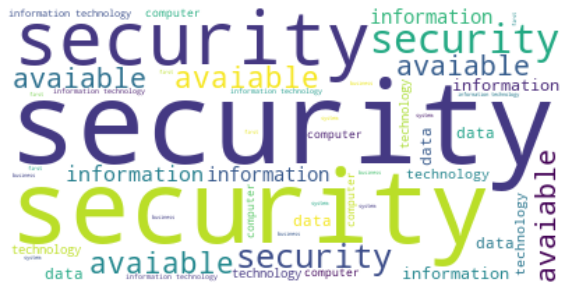

Top Words for Computer Industry and Food Type Products From Company Background Column


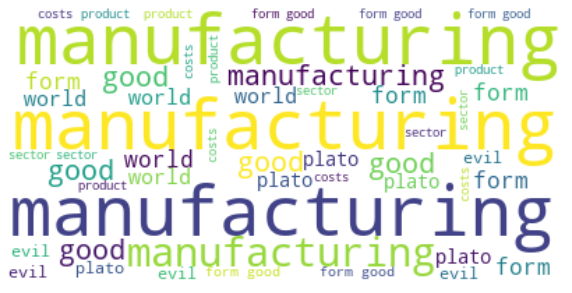

Top Words for Computer Industry and Hardware Type Products From Company Background Column


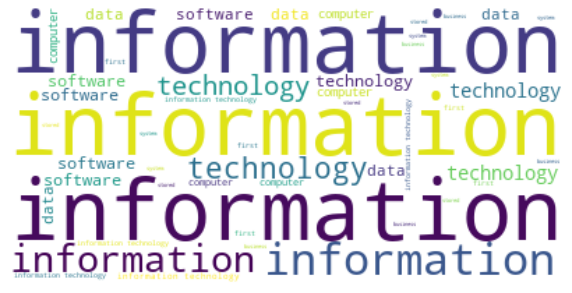

Top Words for Computer Industry and Production Type Products From Company Background Column


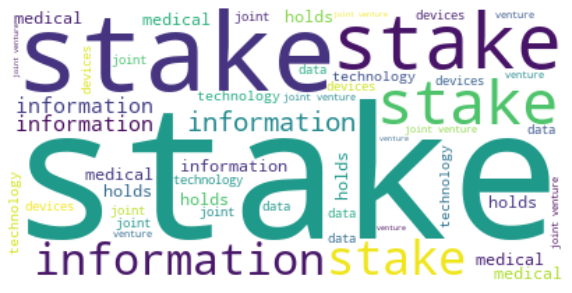

Top Words for Computer Industry and non green energy Type Products From Company Background Column


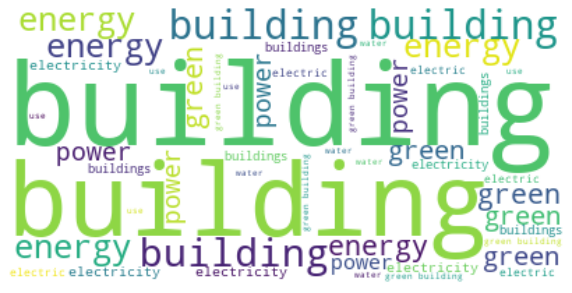

Top Words for Computer Industry and Mechanical Type Products From Company Background Column


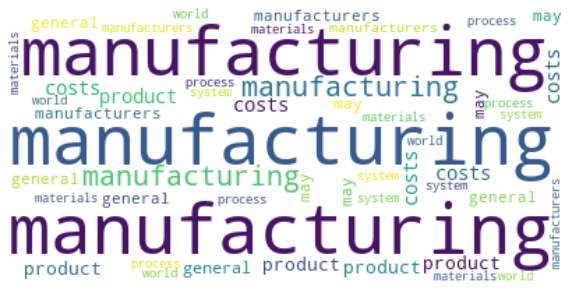

Top Words for Power Industry and Toys Type Products From Company Background Column


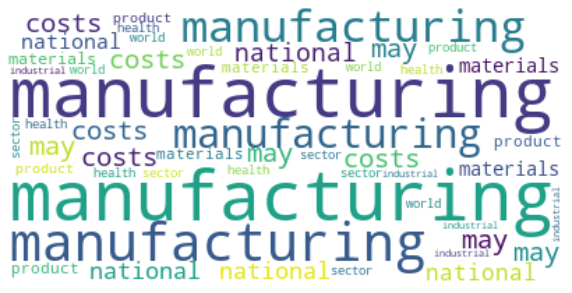

Top Words for Power Industry and Diagnostic Type Products From Company Background Column


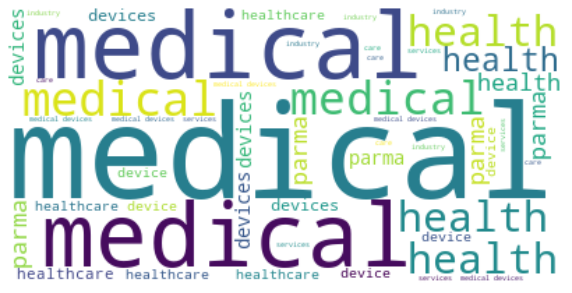

Top Words for Power Industry and Software Type Products From Company Background Column


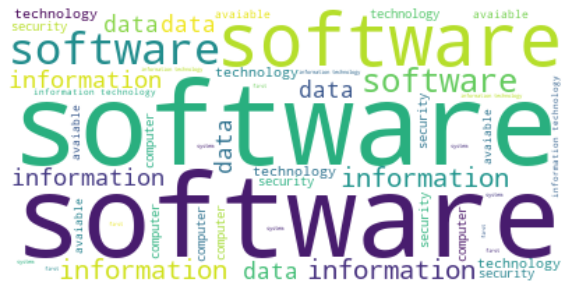

Top Words for Power Industry and green energy Type Products From Company Background Column


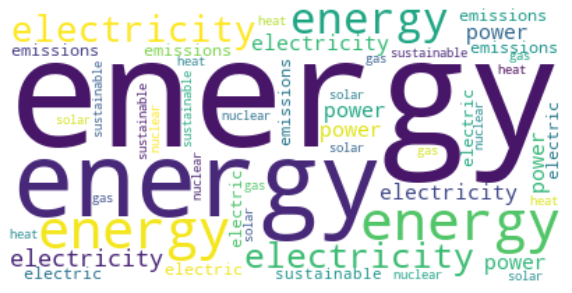

Top Words for Power Industry and Heavy Vehicles Type Products From Company Background Column


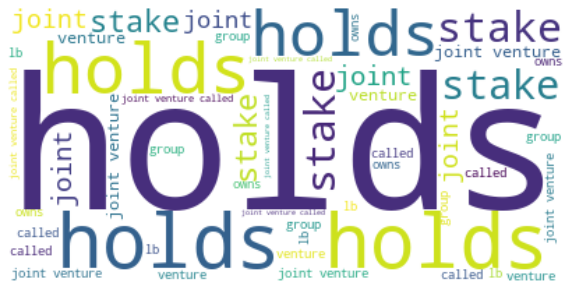

Top Words for Power Industry and Light Vehicles Type Products From Company Background Column


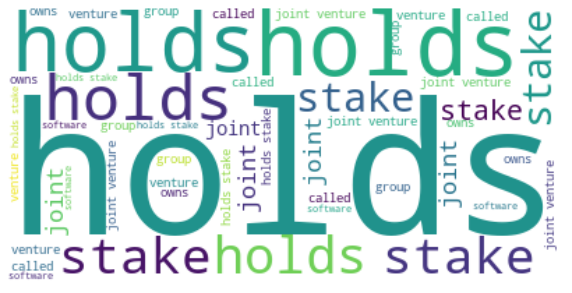

Top Words for Power Industry and Pharma Type Products From Company Background Column


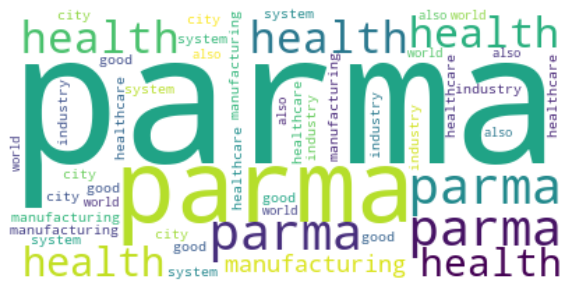

Top Words for Power Industry and Security Type Products From Company Background Column


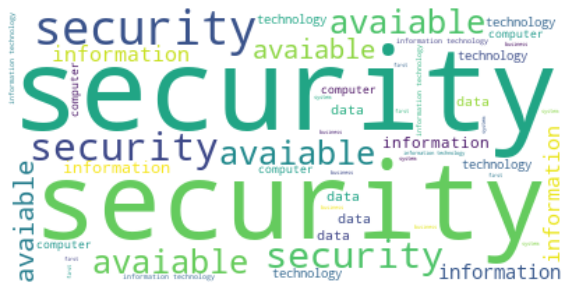

Top Words for Power Industry and Food Type Products From Company Background Column


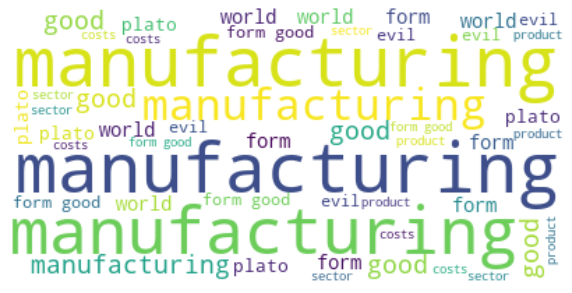

Top Words for Power Industry and Hardware Type Products From Company Background Column


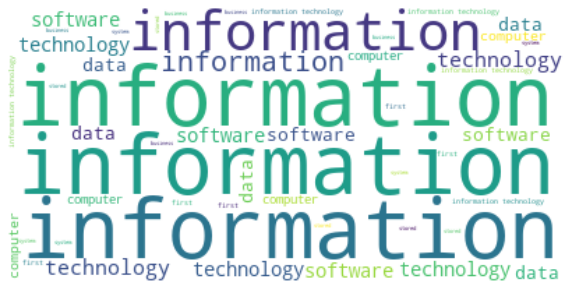

Top Words for Power Industry and Production Type Products From Company Background Column


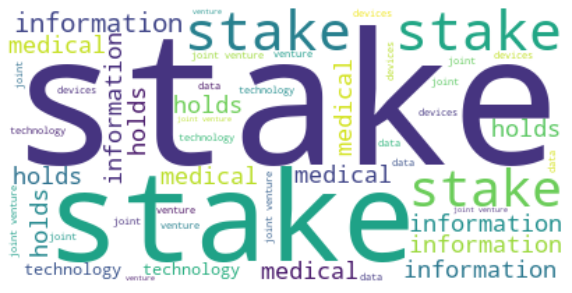

Top Words for Power Industry and non green energy Type Products From Company Background Column


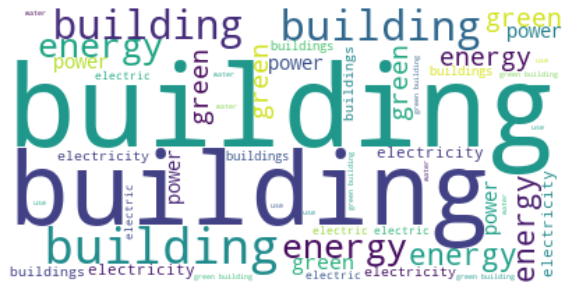

Top Words for Power Industry and Mechanical Type Products From Company Background Column


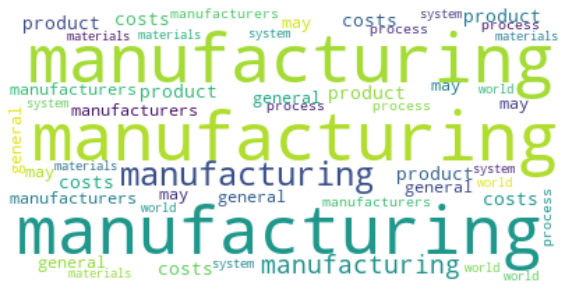

Top Words for Automobile Industry and Toys Type Products From Company Background Column


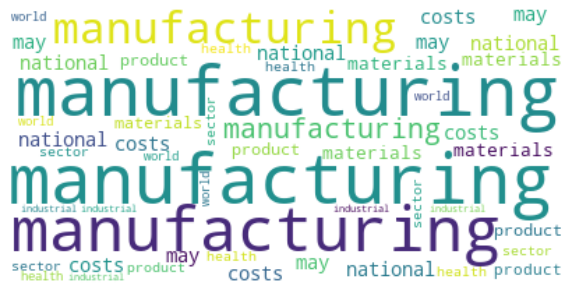

Top Words for Automobile Industry and Diagnostic Type Products From Company Background Column


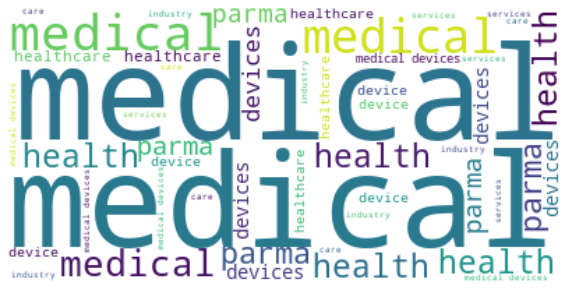

Top Words for Automobile Industry and Software Type Products From Company Background Column


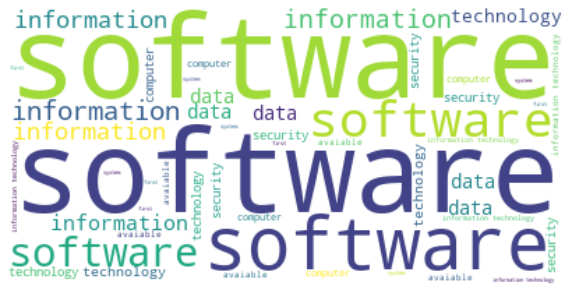

Top Words for Automobile Industry and green energy Type Products From Company Background Column


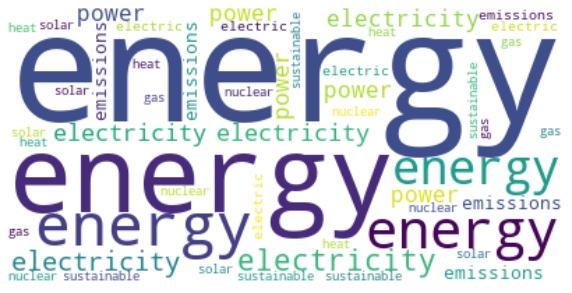

Top Words for Automobile Industry and Heavy Vehicles Type Products From Company Background Column


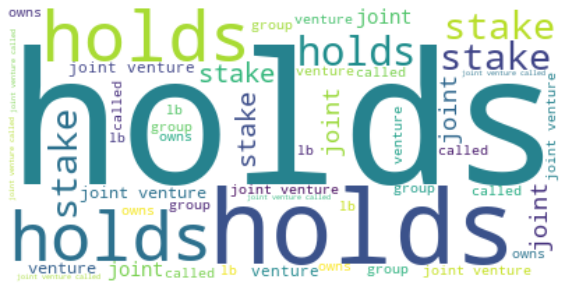

Top Words for Automobile Industry and Light Vehicles Type Products From Company Background Column


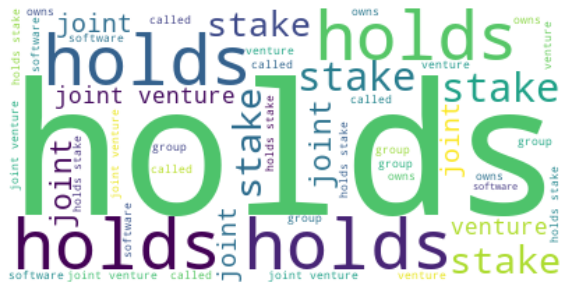

Top Words for Automobile Industry and Pharma Type Products From Company Background Column


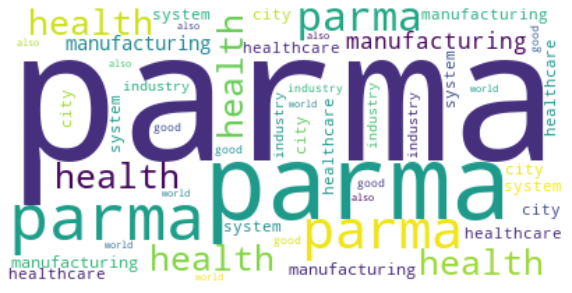

Top Words for Automobile Industry and Security Type Products From Company Background Column


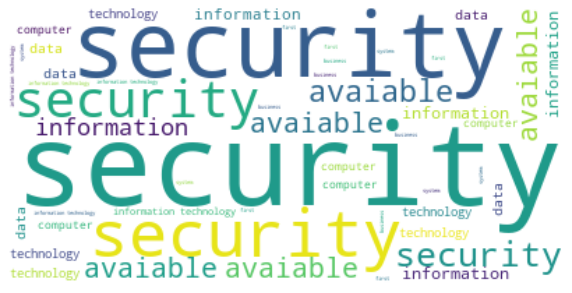

Top Words for Automobile Industry and Food Type Products From Company Background Column


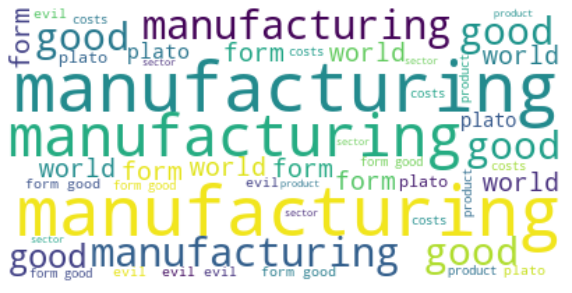

Top Words for Automobile Industry and Hardware Type Products From Company Background Column


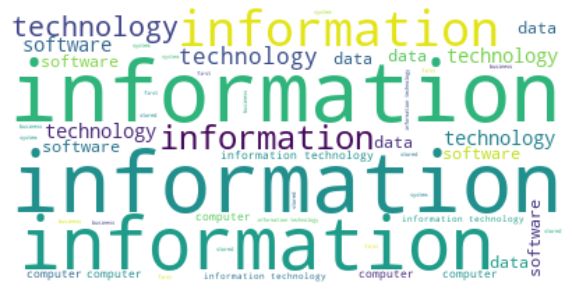

Top Words for Automobile Industry and Production Type Products From Company Background Column


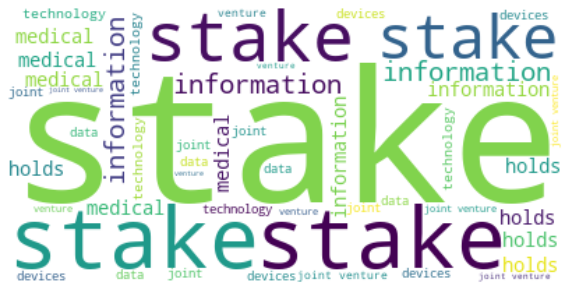

Top Words for Automobile Industry and non green energy Type Products From Company Background Column


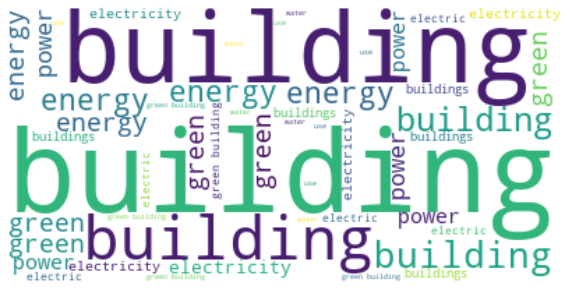

Top Words for Automobile Industry and Mechanical Type Products From Company Background Column


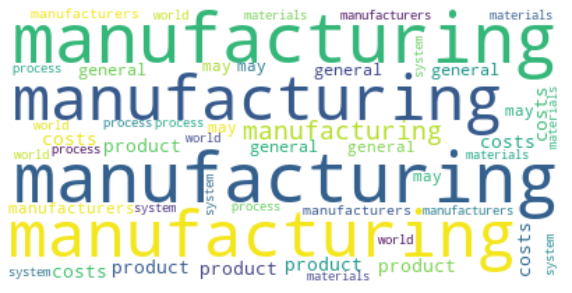

In [14]:
create_word_clouds(bck_top_words,'Company Background')

### Word Cloud From Product Info

Top Words for Manufacturing Industry From Product Info Column


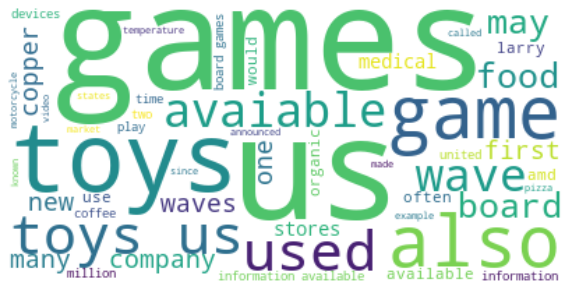

Top Words for Health Industry From Product Info Column


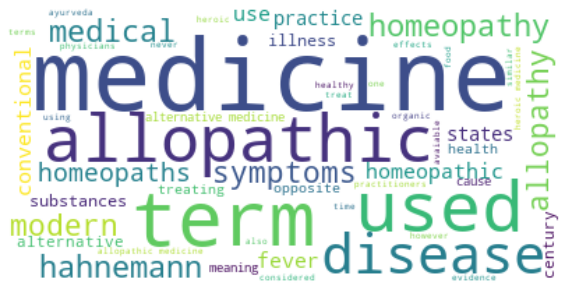

Top Words for Computer Industry From Product Info Column


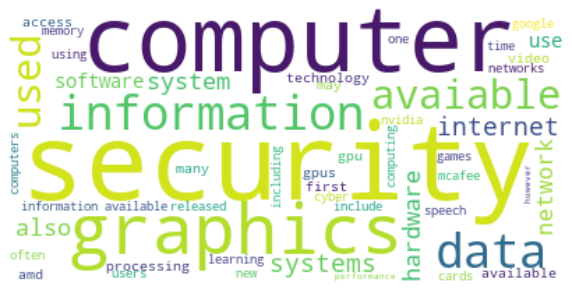

Top Words for Power Industry From Product Info Column


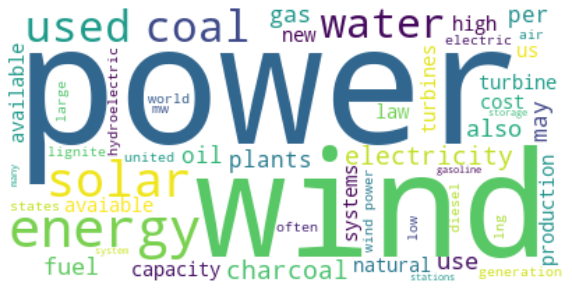

Top Words for Automobile Industry From Product Info Column


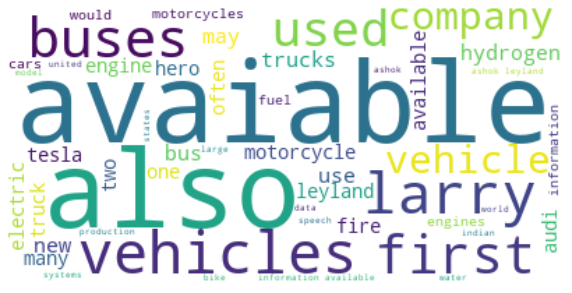

Top Words for Manufacturing Industry and Toys Type Products From Product Info Column


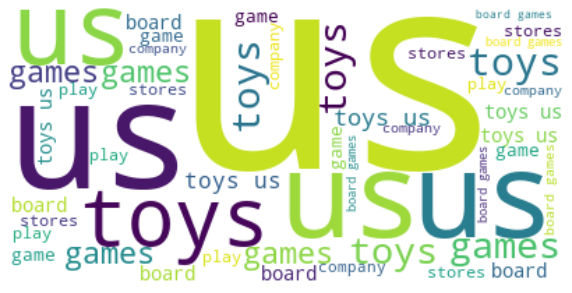

Top Words for Manufacturing Industry and Diagnostic Type Products From Product Info Column


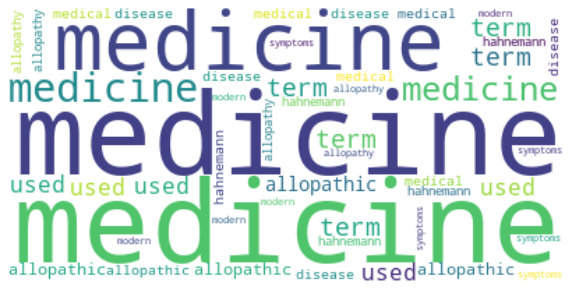

Top Words for Manufacturing Industry and Software Type Products From Product Info Column


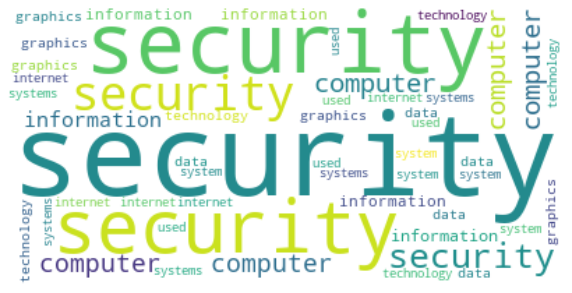

Top Words for Manufacturing Industry and green energy Type Products From Product Info Column


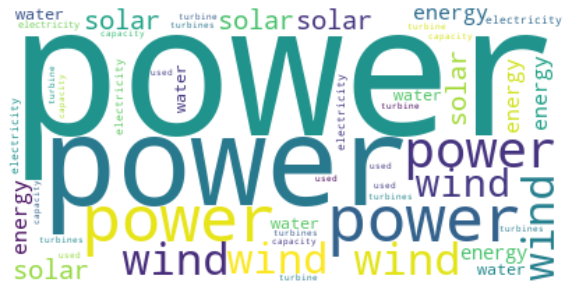

Top Words for Manufacturing Industry and Heavy Vehicles Type Products From Product Info Column


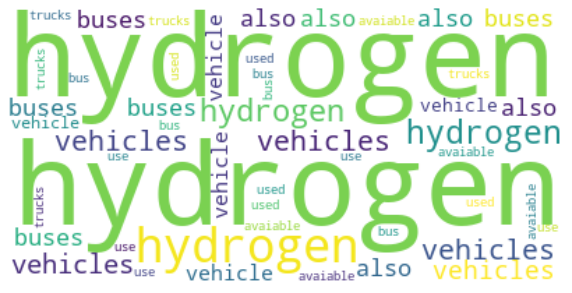

Top Words for Manufacturing Industry and Light Vehicles Type Products From Product Info Column


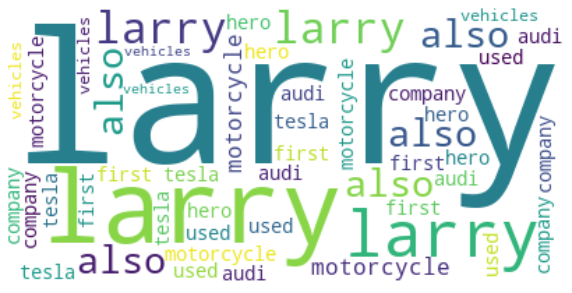

Top Words for Manufacturing Industry and Pharma Type Products From Product Info Column


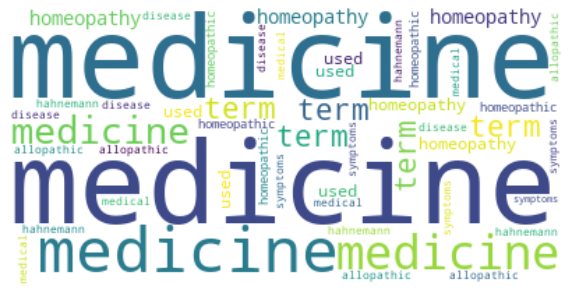

Top Words for Manufacturing Industry and Security Type Products From Product Info Column


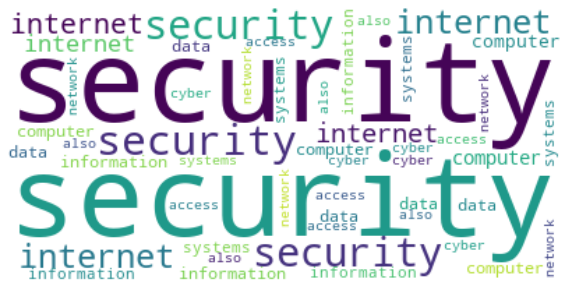

Top Words for Manufacturing Industry and Food Type Products From Product Info Column


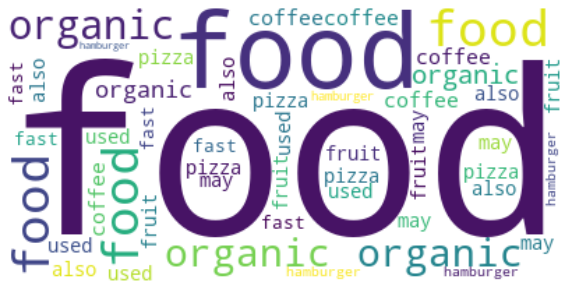

Top Words for Manufacturing Industry and Hardware Type Products From Product Info Column


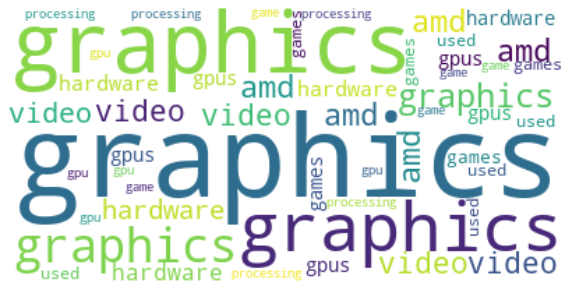

Top Words for Manufacturing Industry and Production Type Products From Product Info Column


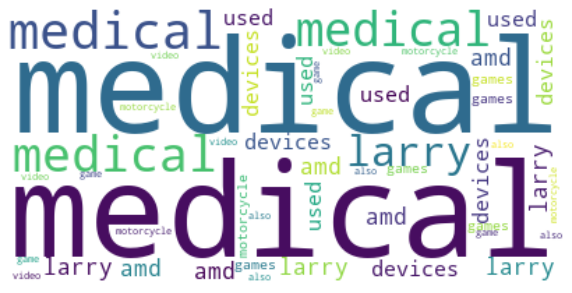

Top Words for Manufacturing Industry and non green energy Type Products From Product Info Column


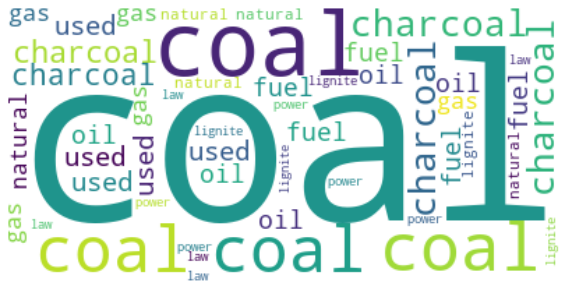

Top Words for Manufacturing Industry and Mechanical Type Products From Product Info Column


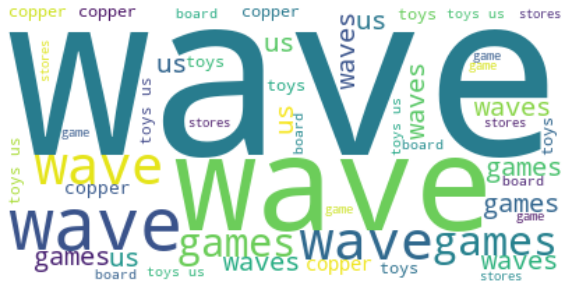

Top Words for Health Industry and Toys Type Products From Product Info Column


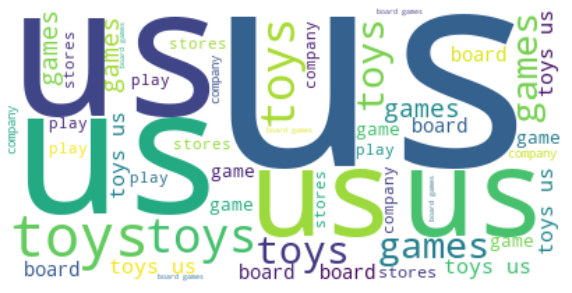

Top Words for Health Industry and Diagnostic Type Products From Product Info Column


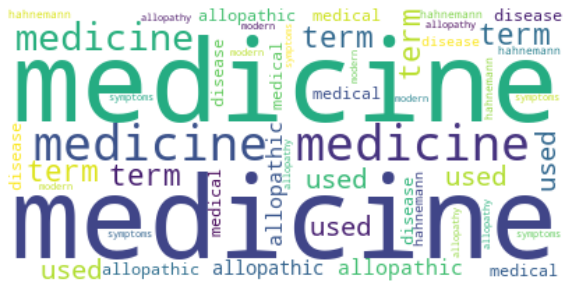

Top Words for Health Industry and Software Type Products From Product Info Column


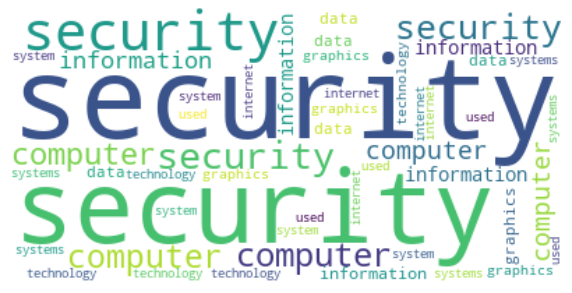

Top Words for Health Industry and green energy Type Products From Product Info Column


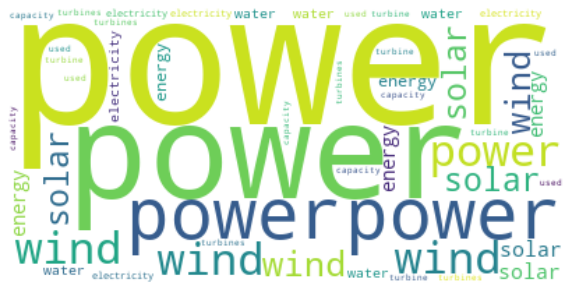

Top Words for Health Industry and Heavy Vehicles Type Products From Product Info Column


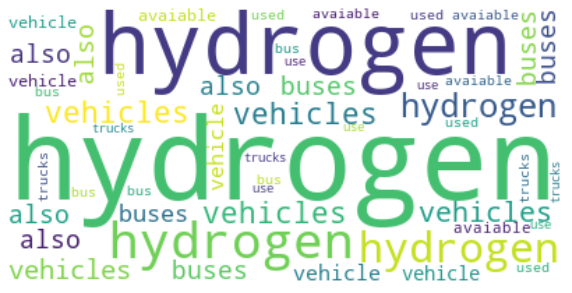

Top Words for Health Industry and Light Vehicles Type Products From Product Info Column


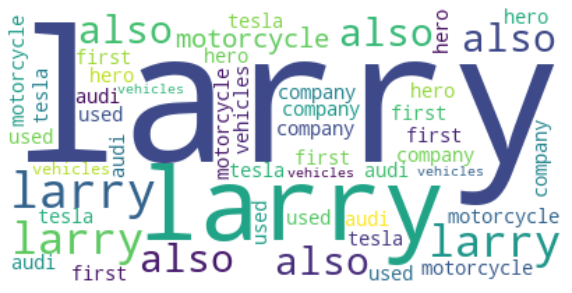

Top Words for Health Industry and Pharma Type Products From Product Info Column


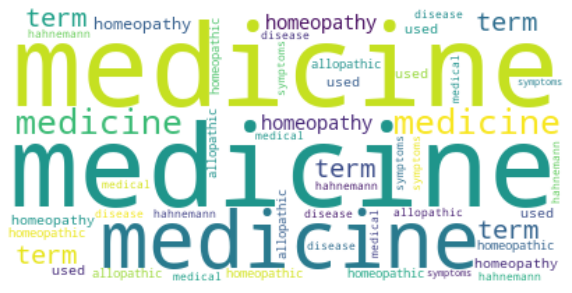

Top Words for Health Industry and Security Type Products From Product Info Column


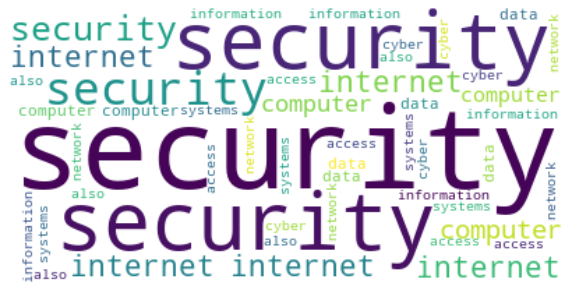

Top Words for Health Industry and Food Type Products From Product Info Column


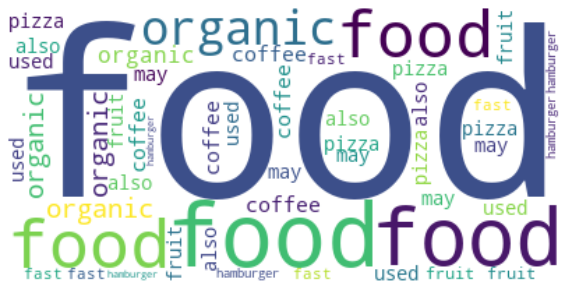

Top Words for Health Industry and Hardware Type Products From Product Info Column


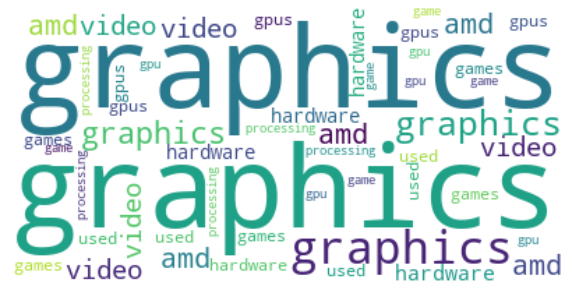

Top Words for Health Industry and Production Type Products From Product Info Column


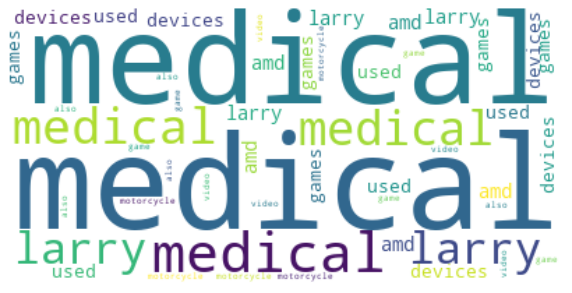

Top Words for Health Industry and non green energy Type Products From Product Info Column


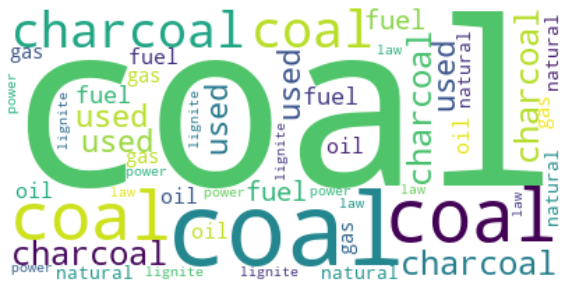

Top Words for Health Industry and Mechanical Type Products From Product Info Column


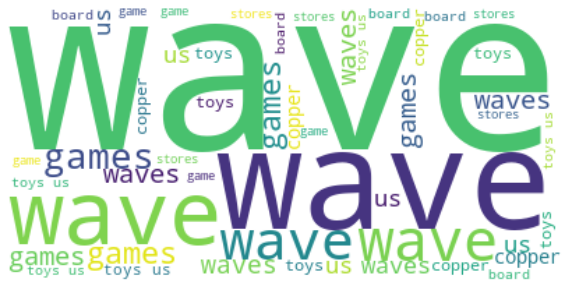

Top Words for Computer Industry and Toys Type Products From Product Info Column


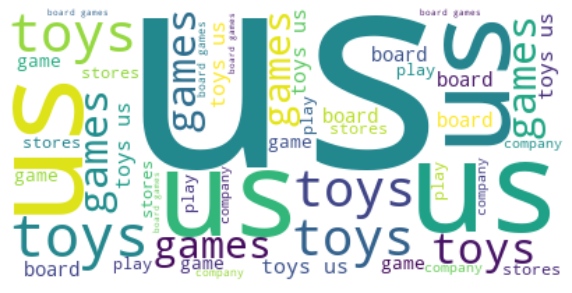

Top Words for Computer Industry and Diagnostic Type Products From Product Info Column


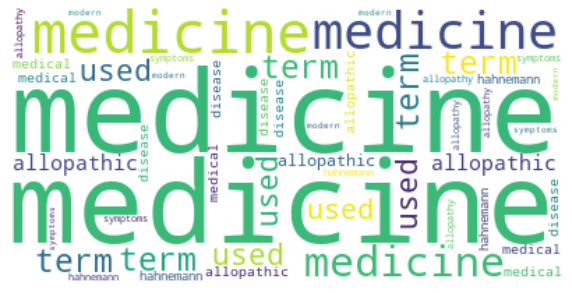

Top Words for Computer Industry and Software Type Products From Product Info Column


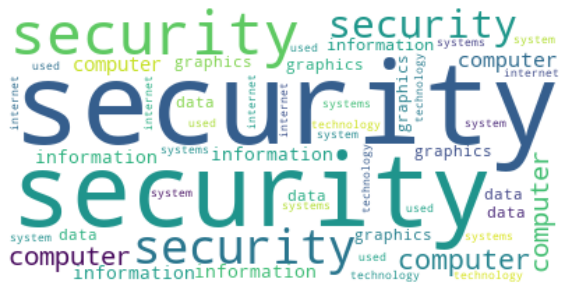

Top Words for Computer Industry and green energy Type Products From Product Info Column


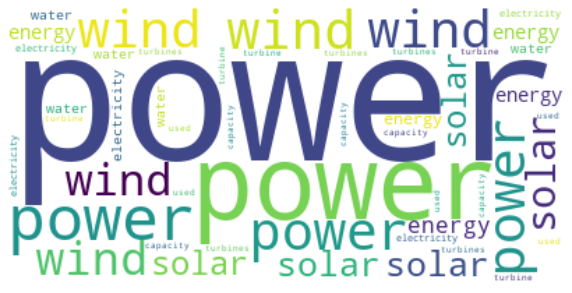

Top Words for Computer Industry and Heavy Vehicles Type Products From Product Info Column


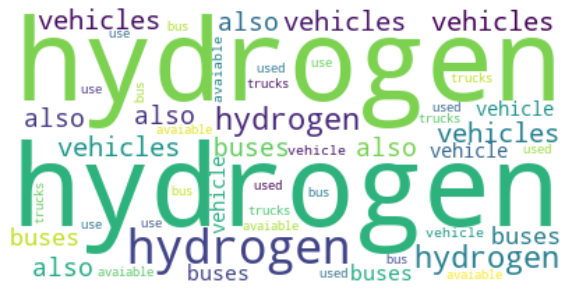

Top Words for Computer Industry and Light Vehicles Type Products From Product Info Column


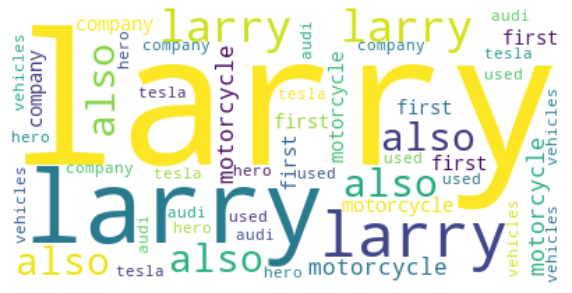

Top Words for Computer Industry and Pharma Type Products From Product Info Column


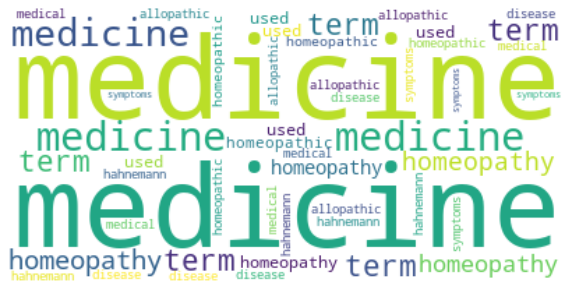

Top Words for Computer Industry and Security Type Products From Product Info Column


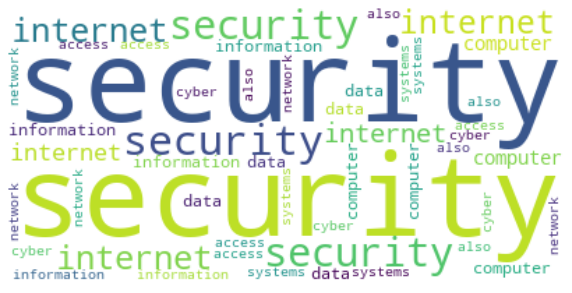

Top Words for Computer Industry and Food Type Products From Product Info Column


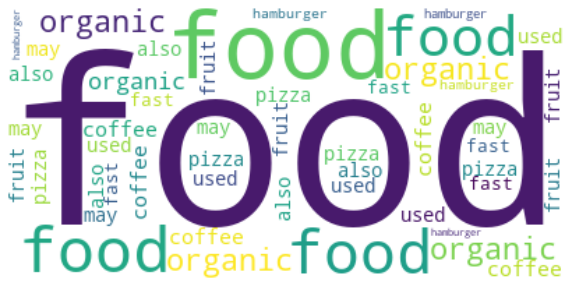

Top Words for Computer Industry and Hardware Type Products From Product Info Column


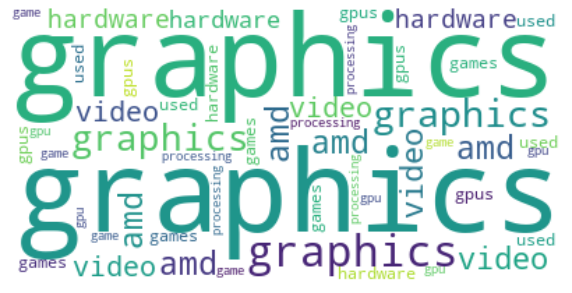

Top Words for Computer Industry and Production Type Products From Product Info Column


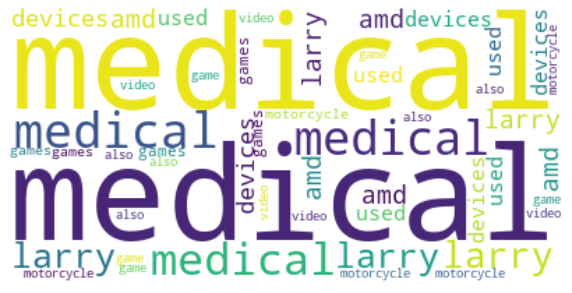

Top Words for Computer Industry and non green energy Type Products From Product Info Column


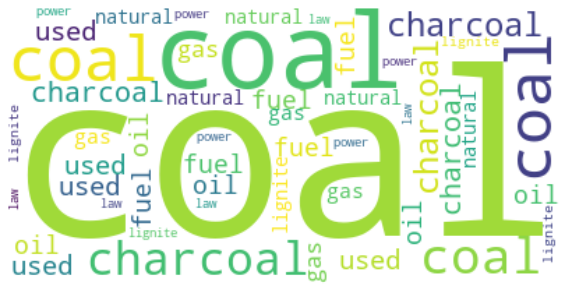

Top Words for Computer Industry and Mechanical Type Products From Product Info Column


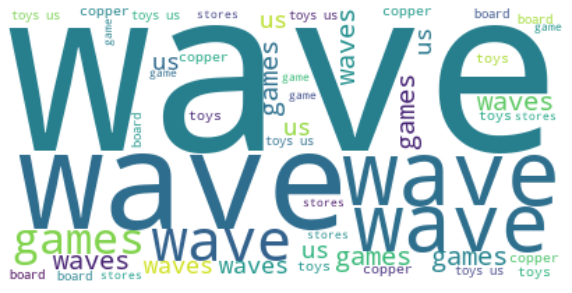

Top Words for Power Industry and Toys Type Products From Product Info Column


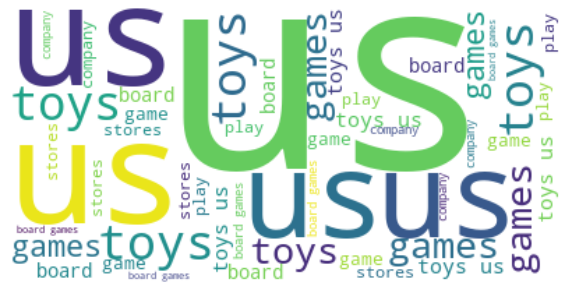

Top Words for Power Industry and Diagnostic Type Products From Product Info Column


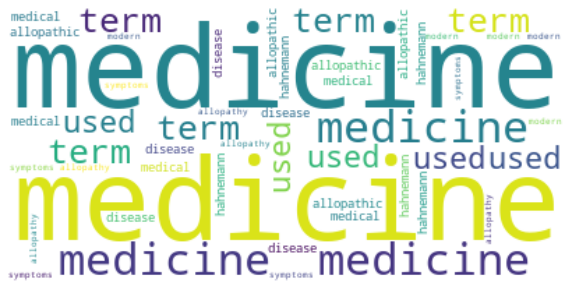

Top Words for Power Industry and Software Type Products From Product Info Column


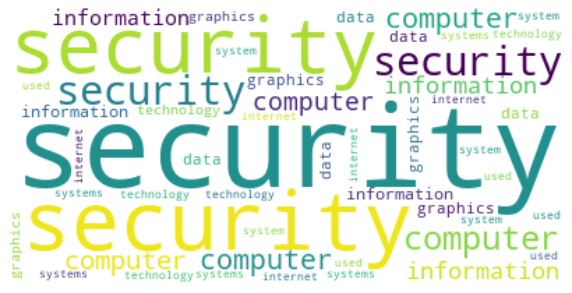

Top Words for Power Industry and green energy Type Products From Product Info Column


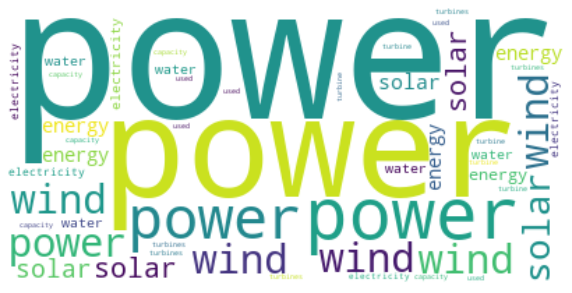

Top Words for Power Industry and Heavy Vehicles Type Products From Product Info Column


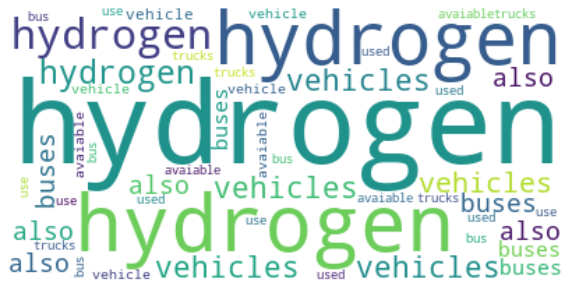

Top Words for Power Industry and Light Vehicles Type Products From Product Info Column


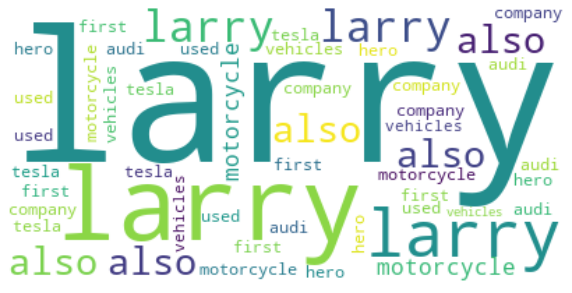

Top Words for Power Industry and Pharma Type Products From Product Info Column


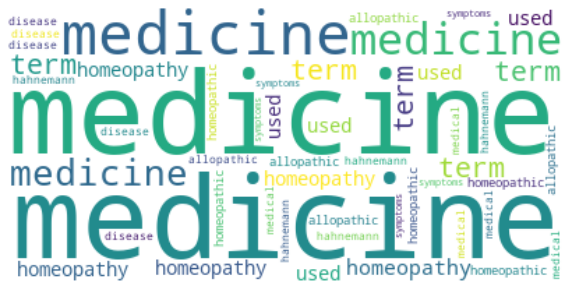

Top Words for Power Industry and Security Type Products From Product Info Column


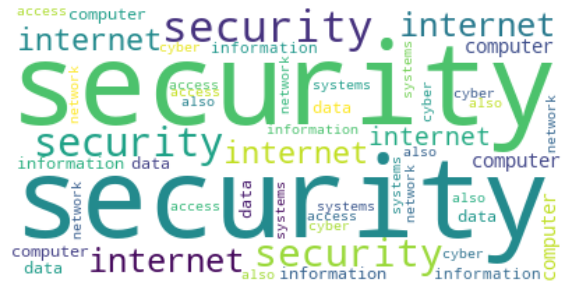

Top Words for Power Industry and Food Type Products From Product Info Column


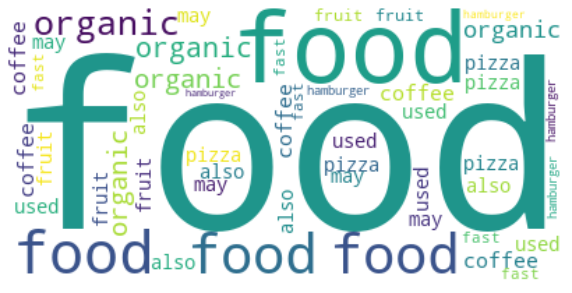

Top Words for Power Industry and Hardware Type Products From Product Info Column


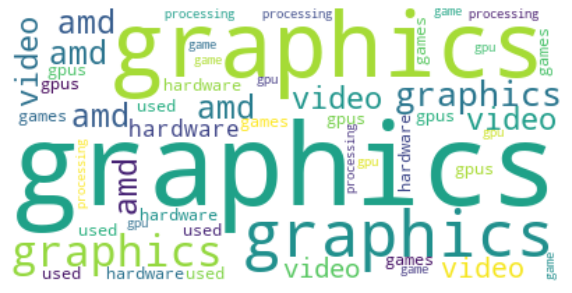

Top Words for Power Industry and Production Type Products From Product Info Column


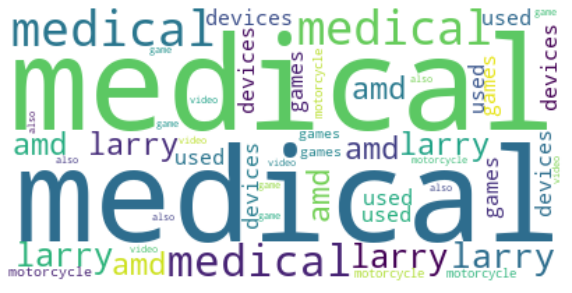

Top Words for Power Industry and non green energy Type Products From Product Info Column


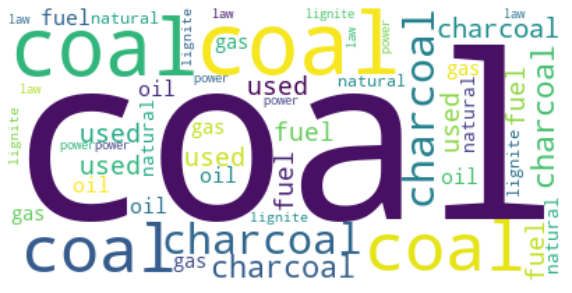

Top Words for Power Industry and Mechanical Type Products From Product Info Column


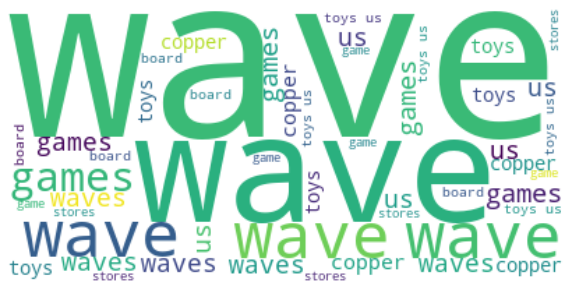

Top Words for Automobile Industry and Toys Type Products From Product Info Column


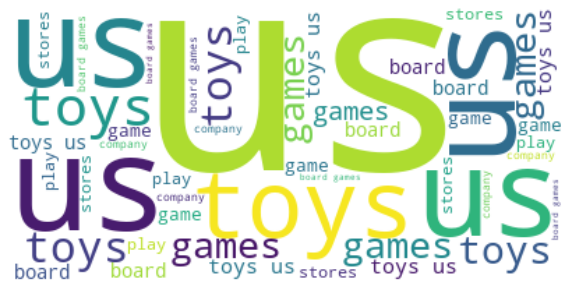

Top Words for Automobile Industry and Diagnostic Type Products From Product Info Column


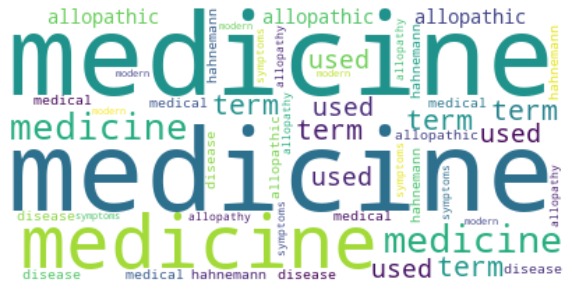

Top Words for Automobile Industry and Software Type Products From Product Info Column


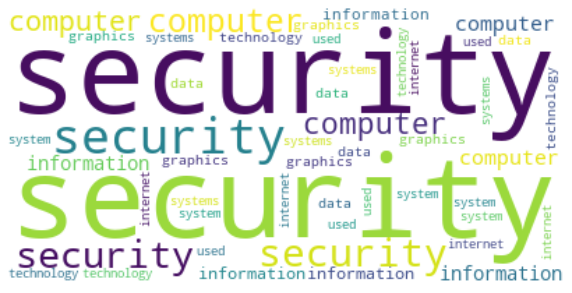

Top Words for Automobile Industry and green energy Type Products From Product Info Column


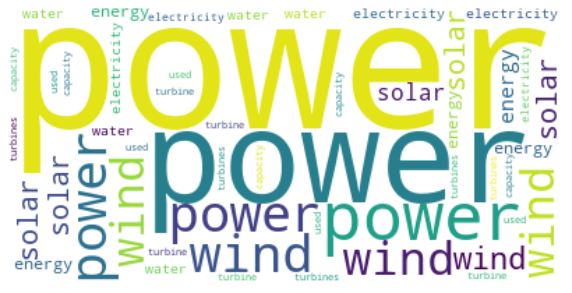

Top Words for Automobile Industry and Heavy Vehicles Type Products From Product Info Column


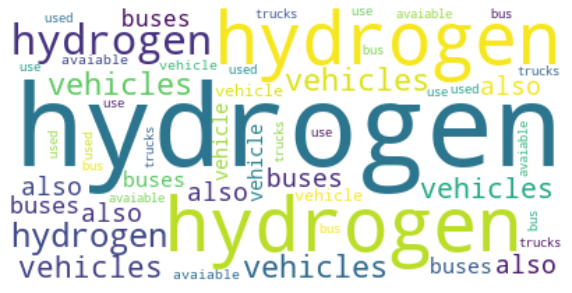

Top Words for Automobile Industry and Light Vehicles Type Products From Product Info Column


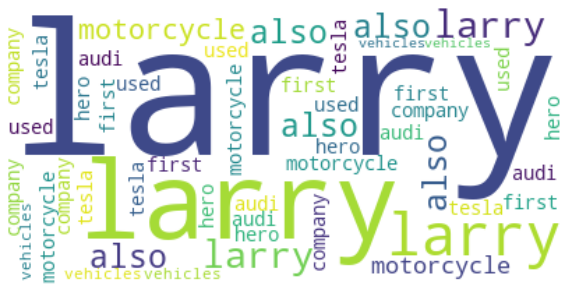

Top Words for Automobile Industry and Pharma Type Products From Product Info Column


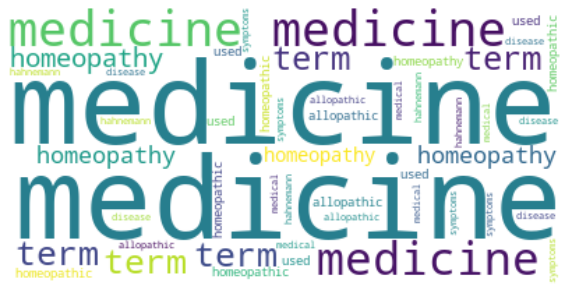

Top Words for Automobile Industry and Security Type Products From Product Info Column


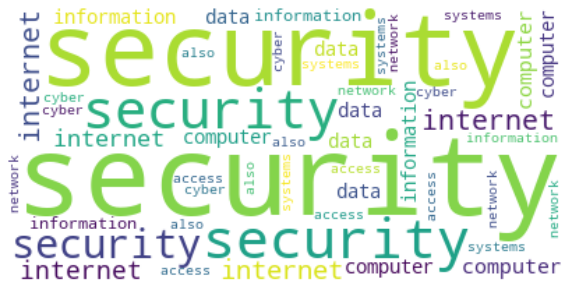

Top Words for Automobile Industry and Food Type Products From Product Info Column


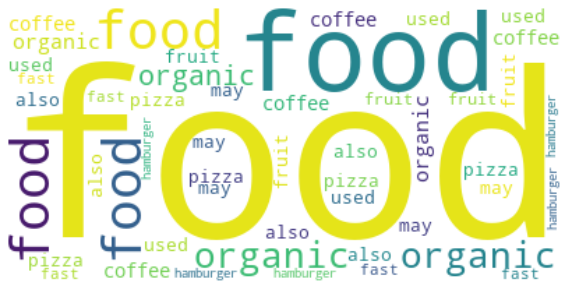

Top Words for Automobile Industry and Hardware Type Products From Product Info Column


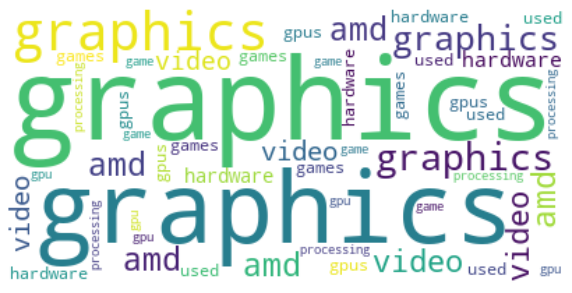

Top Words for Automobile Industry and Production Type Products From Product Info Column


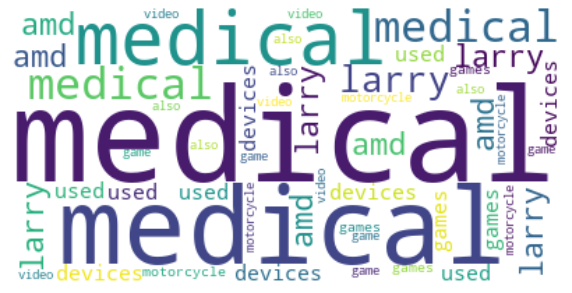

Top Words for Automobile Industry and non green energy Type Products From Product Info Column


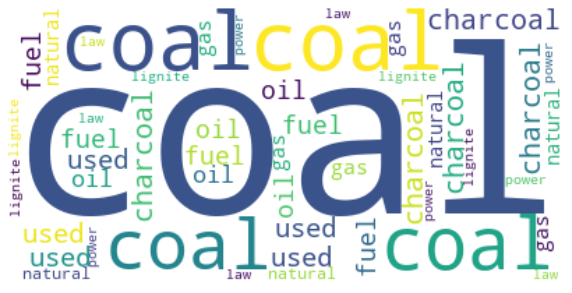

Top Words for Automobile Industry and Mechanical Type Products From Product Info Column


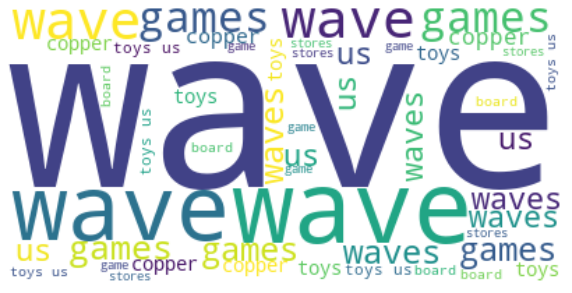

In [15]:
create_word_clouds(inf_top_words,'Product Info')

## Create Final Features For Model Training

In [16]:
oe_prd_info = OrdinalEncoder()
oe_background = OrdinalEncoder()
oe = OrdinalEncoder()
def create_model_inputs(df_train,df_valid,vocab,encoder,column = 'clean'):
    vectorizer = TfidfVectorizer(min_df= 1,
                                 #max_df =100,
                                 lowercase = True,
                                 vocabulary = vocab['word'].drop_duplicates(),
                                 sublinear_tf = True,
                                 stop_words=stop_words,
                                 ngram_range=(1,15)
                                ) 
    vectorizer.fit(df_train[column].apply(lambda x: np.str_(x)))
    x_train = vectorizer.transform(df_train[column].apply(lambda x: np.str_(x)))
    y_train = encoder.fit_transform(df_train[y_columns].values.reshape(-1, 3))
    x_valid = vectorizer.transform(df_valid[column].apply(lambda x: np.str_(x)))
    y_valid = oe.fit_transform(df_valid[y_columns].values.reshape(-1, 3))
    
    print('X training shape', x_train.shape, x_train.dtype)
    print('Y training shape', y_train.shape, y_train.dtype)
    print('X validation shape', x_valid.shape, x_valid.dtype)
    print('Y validation shape', y_valid.shape, y_valid.dtype)
    
    return x_train,y_train,x_valid,y_valid,vectorizer
x_train_prd_info,y_train_prd_info,x_valid_prd_info,y_valid,prd_inf_vec = create_model_inputs(df_train,df_valid,inf_top_words,oe_prd_info,'product_info')
x_train_background,y_train_background,x_valid_background,y_valid,comp_bck_vec = create_model_inputs(df_train,df_valid,bck_top_words,oe_background,'Company_background')

from scipy.sparse import hstack
x_train = hstack((x_train_prd_info, x_train_background))
x_valid = hstack((x_valid_prd_info, x_valid_background))
y_train = y_train_prd_info

X training shape (16736, 181) float64
Y training shape (16736, 3) float64
X validation shape (7173, 181) float64
Y validation shape (7173, 3) float64
X training shape (16736, 109) float64
Y training shape (16736, 3) float64
X validation shape (7173, 109) float64
Y validation shape (7173, 3) float64


## Define Model Functions

In [17]:
def show_feature_importances(clf,prd_vec,bck_vec):
    prd_info_cols = np.array(prd_vec.get_feature_names())
    comp_back_cols = np.array(bck_vec.get_feature_names())
    vectorized_cols = np.concatenate((prd_info_cols,comp_back_cols),axis=0)
    importances = list(clf.feature_importances_)
    feature_importances = [(feature, round(importance, 2)) for feature, importance in zip(vectorized_cols, importances)]
    feature_importances = sorted(feature_importances, key = lambda x: x[1], reverse = True)
    feature_importances = feature_importances[:30]
    fig, ax = plt.subplots(1, 1, figsize=(8, 12))
    sns.barplot(y=pd.DataFrame(feature_importances)[0], x=pd.DataFrame(feature_importances)[1], ax=ax);
    ax.set_xlabel('Feature Importance')
    ax.set_ylabel('Features')
    ax.set_title('Feature Importance Plot')
    plt.show();
    

def run_models(classifier, x_train, y_train,x_valid, y_valid):
    clf = MultiOutputClassifier(classifier)
    print(clf.fit(x_train,y_train))
    y_pred_probas = clf.predict_proba(x_valid)
    y_pred = clf.predict(x_valid)
    score1 = 100*f1_score(y_valid[:,0], y_pred[:,0],average='weighted')
    score2 = 100*f1_score(y_valid[:,1], y_pred[:,1], average='weighted')
    score3 = 100*f1_score(y_valid[:,2], y_pred[:,2], average='weighted')
    eval_metric = 0.5*score1 +0.3*score2 +0.2*score3
    print('Score1 : ',score1)
    print('Score2 : ',score2)
    print('Score3 : ',score3)
    print('Eval_score : ',eval_metric)
    print('-----Looking at Individual Model Performances-------------------\n')
    print('Model For Industry\n')
    
    print ('Accuracy:',accuracy_score(y_valid[:,0], y_pred[:,0]))
    print ('F1 Score:',f1_score(y_valid[:,0], y_pred[:,0], average = 'weighted'))
    print ('Recall:',recall_score(y_valid[:,0], y_pred[:,0], average = 'weighted'))
    print ('Precision:',precision_score(y_valid[:,0], y_pred[:,0], average = 'weighted'))
    print ('Classification report:',classification_report(y_valid[:,0], y_pred[:,0]))
    conf_mat = confusion_matrix(y_valid[:,0], y_pred[:,0])
    
    plt.figure(figsize = (10,7))
    sns.heatmap(conf_mat, annot=True, fmt="d")
    plt.title("Confusion_matrix")
    plt.xlabel("Predicted")
    plt.ylabel("Original")   
    plt.show()    
    
    
    
    
    try:
        show_feature_importances(clf.estimators_[0],prd_inf_vec,comp_bck_vec)
        print('----------------------Feature Importances From Industry Model------------------------')
    except:
        pass
    
    
    
    print('\nModel For Type\n')
    
    print ('Accuracy:',accuracy_score(y_valid[:,1], y_pred[:,1]))
    print ('F1 Score:',f1_score(y_valid[:,1], y_pred[:,1], average = 'weighted'))
    print ('Recall:',recall_score(y_valid[:,1], y_pred[:,1], average = 'weighted'))
    print ('Precision:',precision_score(y_valid[:,1], y_pred[:,1], average = 'weighted'))
    print ('Classification report:',classification_report(y_valid[:,1], y_pred[:,1]))
    conf_mat = confusion_matrix(y_valid[:,1], y_pred[:,1])
    
    plt.figure(figsize = (10,7))
    sns.heatmap(conf_mat, annot=True, fmt="d")
    plt.title("Confusion_matrix")
    plt.xlabel("Predicted")
    plt.ylabel("Original")   
    plt.show()
    
    
    
    try:
        show_feature_importances(clf.estimators_[1],prd_inf_vec,comp_bck_vec)
        print('----------------------Feature Importances From Type Model------------------------')
    except:
        pass

    print('\nModel For Product\n')
    
    print ('Accuracy:',accuracy_score(y_valid[:,2], y_pred[:,2]))
    print ('F1 Score:',f1_score(y_valid[:,2], y_pred[:,2], average = 'weighted'))
    print ('Recall:',recall_score(y_valid[:,2], y_pred[:,2], average = 'weighted'))
    print ('Precision:',precision_score(y_valid[:,2], y_pred[:,2], average = 'weighted'))
    print ('Classification report:',classification_report(y_valid[:,2], y_pred[:,2]))
    conf_mat = confusion_matrix(y_valid[:,2], y_pred[:,2])
    
    plt.figure(figsize = (10,7))
    sns.heatmap(conf_mat, annot=True, fmt="d")
    plt.title("Confusion_matrix")
    plt.xlabel("Predicted")
    plt.ylabel("Original")   
    plt.show() 
    
    
    
    
    try:
        show_feature_importances(clf.estimators_[2],prd_inf_vec,comp_bck_vec)
        print('----------------------Feature Importances From Product Model------------------------')
    except:
        pass




# Model training

##### Logistic Regression is performing slighly better than the other ones, However based on overall performance and better explainability lets choose Random Forest to go ahead with

## Logistic Regression

MultiOutputClassifier(estimator=LogisticRegression(C=1.0, class_weight=None,
                                                   dual=False,
                                                   fit_intercept=True,
                                                   intercept_scaling=1,
                                                   l1_ratio=None, max_iter=100,
                                                   multi_class='auto',
                                                   n_jobs=None, penalty='l2',
                                                   random_state=None,
                                                   solver='liblinear',
                                                   tol=0.0001, verbose=0,
                                                   warm_start=False),
                      n_jobs=None)
Score1 :  85.68584815359608
Score2 :  68.09540452719122
Score3 :  91.73121323660394
Eval_score :  81.61778808227619
-----Looking at Individual Model Performances-------

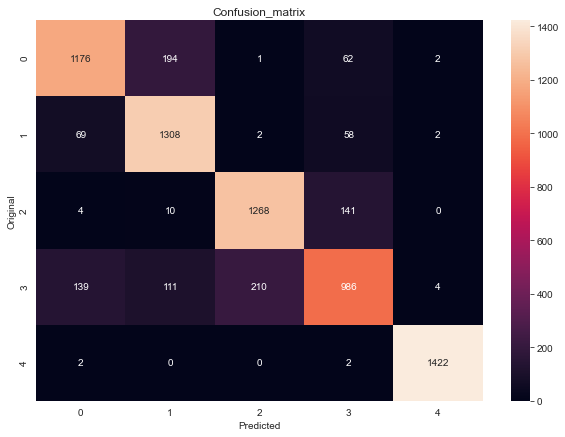


Model For Type

Accuracy: 0.6896695943120034
F1 Score: 0.6809540452719123
Recall: 0.6896695943120034
Precision: 0.6821227676871419
Classification report:               precision    recall  f1-score   support

         0.0       0.53      0.56      0.54       486
         1.0       0.80      0.78      0.79       463
         2.0       0.43      0.36      0.39       418
         3.0       0.69      0.69      0.69       480
         4.0       0.59      0.71      0.64       955
         5.0       0.72      0.80      0.76       309
         6.0       0.75      0.81      0.78       937
         7.0       0.47      0.23      0.31       518
         8.0       0.51      0.42      0.46       288
         9.0       0.52      0.60      0.56       733
        10.0       0.53      0.39      0.45       160
        11.0       0.99      0.99      0.99       864
        12.0       0.99      0.98      0.98       562

    accuracy                           0.69      7173
   macro avg       0.66      0.64

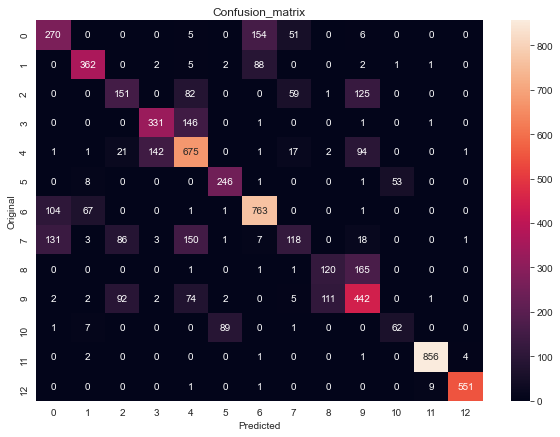


Model For Product

Accuracy: 0.917747107207584
F1 Score: 0.9173121323660394
Recall: 0.917747107207584
Precision: 0.9180483398675856
Classification report:               precision    recall  f1-score   support

         0.0       0.89      0.97      0.92       523
         1.0       0.79      0.75      0.77       153
         2.0       0.96      0.96      0.96       442
         3.0       0.88      0.87      0.87       200
         4.0       0.75      0.79      0.77       282
         5.0       0.91      0.80      0.85       168
         6.0       0.93      0.96      0.95       282
         7.0       0.92      0.87      0.90       310
         8.0       0.88      0.91      0.90       281
         9.0       0.86      0.91      0.89       280
        10.0       0.88      0.79      0.84       154
        11.0       0.84      0.82      0.83       238
        12.0       0.98      0.98      0.98       309
        13.0       0.97      0.96      0.97       416
        14.0       1.00      1.00

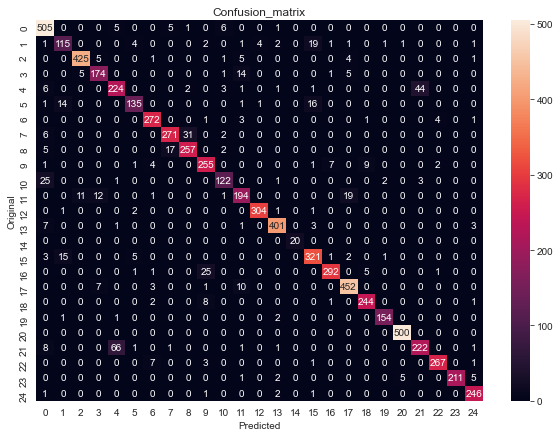

In [18]:
run_models(LogisticRegression(solver = 'liblinear'),x_train,y_train,x_valid,y_valid)

## SGD Classifier

MultiOutputClassifier(estimator=SGDClassifier(alpha=0.0001, average=False,
                                              class_weight='balanced',
                                              early_stopping=False, epsilon=0.1,
                                              eta0=0.0, fit_intercept=True,
                                              l1_ratio=0.15,
                                              learning_rate='optimal',
                                              loss='log', max_iter=1000,
                                              n_iter_no_change=5, n_jobs=-1,
                                              penalty='l2', power_t=0.5,
                                              random_state=1, shuffle=True,
                                              tol=0.001,
                                              validation_fraction=0.1,
                                              verbose=0, warm_start=False),
                      n_jobs=None)
Score1 :  85.70181574644312

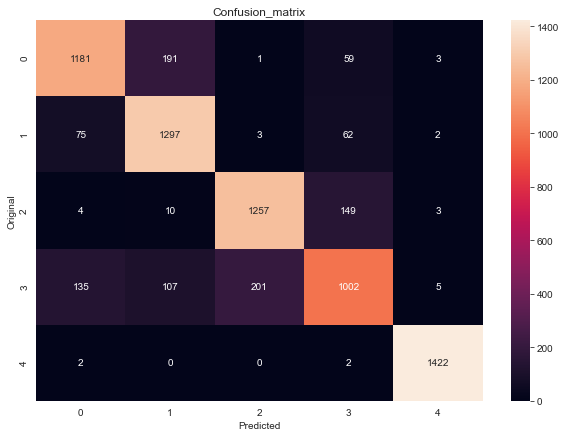


Model For Type

Accuracy: 0.6792137181095775
F1 Score: 0.6733108863953071
Recall: 0.6792137181095775
Precision: 0.687911097351876
Classification report:               precision    recall  f1-score   support

         0.0       0.52      0.72      0.60       486
         1.0       0.75      0.83      0.79       463
         2.0       0.41      0.52      0.46       418
         3.0       0.63      0.86      0.73       480
         4.0       0.64      0.51      0.57       955
         5.0       0.83      0.61      0.70       309
         6.0       0.80      0.70      0.74       937
         7.0       0.45      0.26      0.33       518
         8.0       0.47      0.78      0.59       288
         9.0       0.54      0.40      0.46       733
        10.0       0.51      0.76      0.61       160
        11.0       0.98      0.99      0.99       864
        12.0       0.98      0.98      0.98       562

    accuracy                           0.68      7173
   macro avg       0.65      0.69 

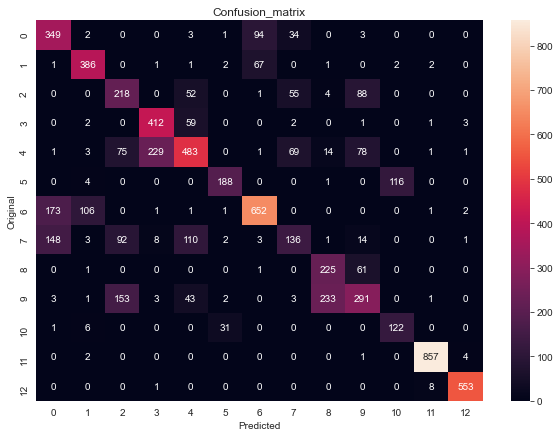


Model For Product

Accuracy: 0.9131465216785166
F1 Score: 0.9135410705478055
Recall: 0.9131465216785166
Precision: 0.9152528612554034
Classification report:               precision    recall  f1-score   support

         0.0       0.92      0.91      0.91       523
         1.0       0.71      0.82      0.76       153
         2.0       0.97      0.96      0.96       442
         3.0       0.86      0.88      0.87       200
         4.0       0.76      0.75      0.76       282
         5.0       0.87      0.82      0.84       168
         6.0       0.94      0.96      0.95       282
         7.0       0.93      0.85      0.89       310
         8.0       0.85      0.94      0.90       281
         9.0       0.86      0.91      0.88       280
        10.0       0.77      0.86      0.81       154
        11.0       0.81      0.82      0.82       238
        12.0       0.99      0.97      0.98       309
        13.0       0.98      0.95      0.97       416
        14.0       0.62      1.

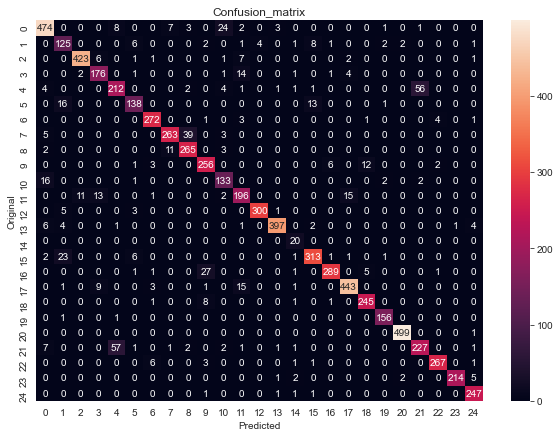

In [19]:
run_models(SGDClassifier(random_state=1, loss='log',class_weight='balanced', n_jobs=-1),x_train,y_train,x_valid,y_valid)

## Random Forest

MultiOutputClassifier(estimator=RandomForestClassifier(bootstrap=True,
                                                       ccp_alpha=0.0,
                                                       class_weight='balanced',
                                                       criterion='gini',
                                                       max_depth=None,
                                                       max_features='auto',
                                                       max_leaf_nodes=None,
                                                       max_samples=None,
                                                       min_impurity_decrease=0.0,
                                                       min_impurity_split=None,
                                                       min_samples_leaf=5,
                                                       min_samples_split=2,
                                                       min_weight_fraction_leaf=0.0,
            

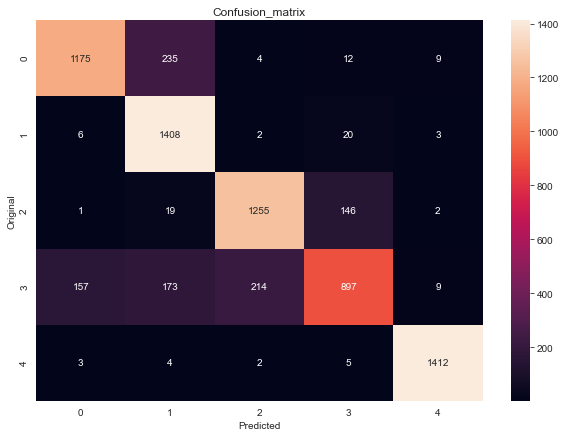

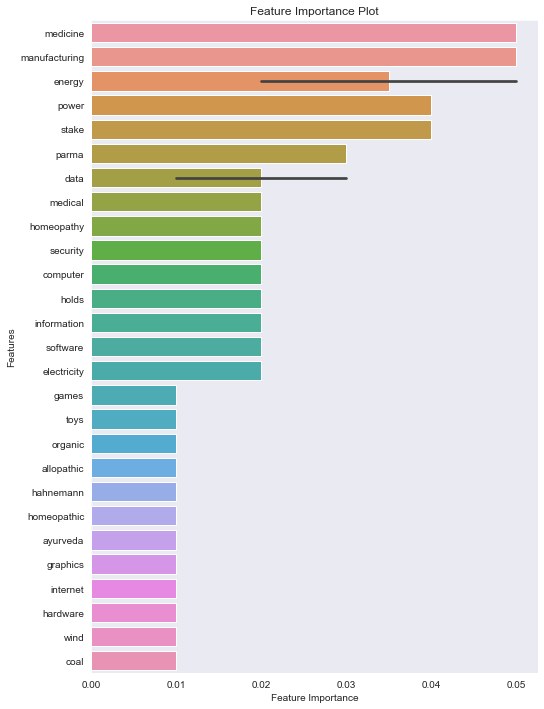

----------------------Feature Importances From Industry Model------------------------

Model For Type

Accuracy: 0.6647149031088805
F1 Score: 0.6440929302440451
Recall: 0.6647149031088805
Precision: 0.6904331156400246
Classification report:               precision    recall  f1-score   support

         0.0       0.53      0.82      0.64       486
         1.0       0.65      0.97      0.78       463
         2.0       0.40      0.80      0.54       418
         3.0       0.62      0.91      0.74       480
         4.0       0.70      0.42      0.53       955
         5.0       0.84      0.51      0.64       309
         6.0       0.90      0.57      0.70       937
         7.0       0.38      0.10      0.16       518
         8.0       0.47      0.87      0.61       288
         9.0       0.52      0.30      0.38       733
        10.0       0.49      0.89      0.63       160
        11.0       0.97      0.97      0.97       864
        12.0       0.94      0.98      0.96       562

 

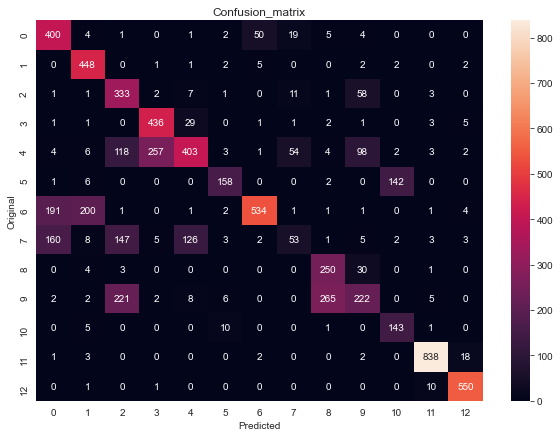

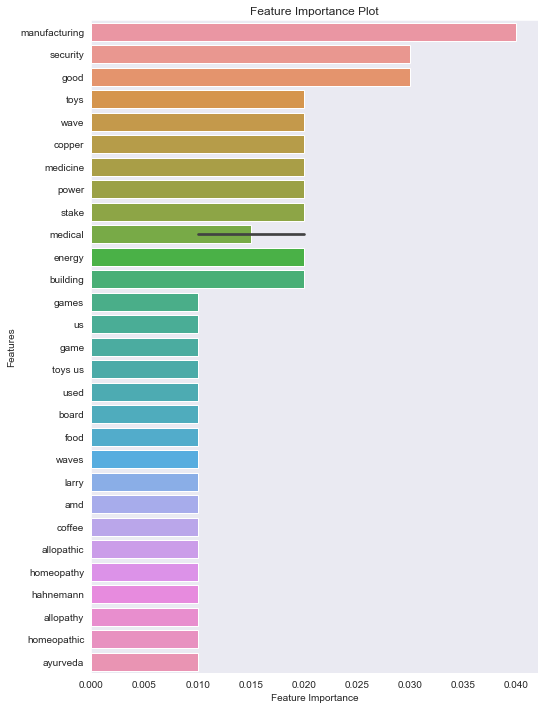

----------------------Feature Importances From Type Model------------------------

Model For Product

Accuracy: 0.8865188902830057
F1 Score: 0.8877948752409133
Recall: 0.8865188902830057
Precision: 0.8921489596608762
Classification report:               precision    recall  f1-score   support

         0.0       0.87      0.89      0.88       523
         1.0       0.63      0.82      0.71       153
         2.0       0.97      0.95      0.96       442
         3.0       0.85      0.83      0.84       200
         4.0       0.75      0.72      0.73       282
         5.0       0.81      0.83      0.82       168
         6.0       0.91      0.93      0.92       282
         7.0       0.93      0.84      0.88       310
         8.0       0.85      0.90      0.87       281
         9.0       0.76      0.90      0.82       280
        10.0       0.70      0.81      0.75       154
        11.0       0.74      0.84      0.78       238
        12.0       0.98      0.96      0.97       309
   

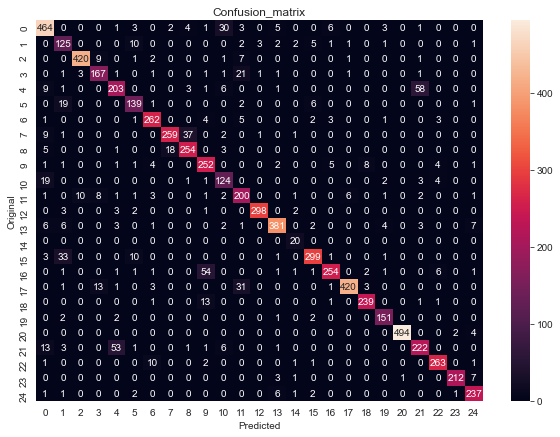

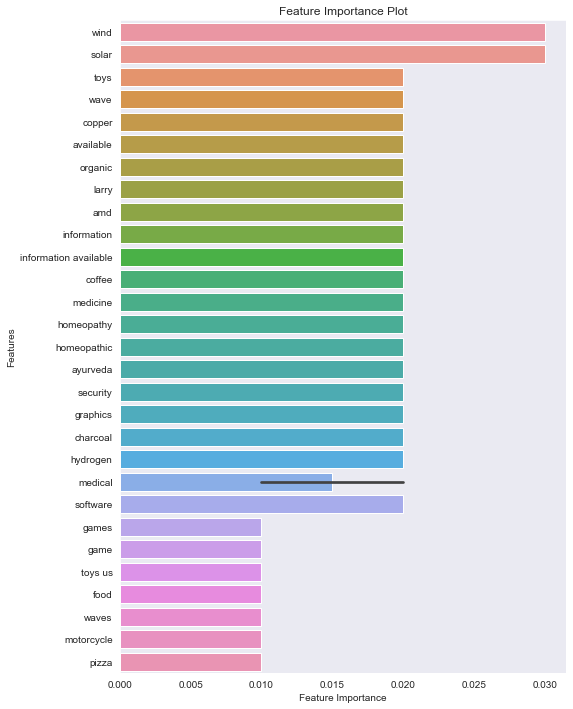

----------------------Feature Importances From Product Model------------------------


In [20]:
run_models(RandomForestClassifier(n_estimators = 300,
                                  random_state=1,
                                  min_samples_leaf = 5,
                                  max_depth=None,
                                  class_weight='balanced', 
                                  n_jobs=-1),x_train,y_train,x_valid,y_valid)

## XGboost

MultiOutputClassifier(estimator=GradientBoostingClassifier(ccp_alpha=0.0,
                                                           criterion='friedman_mse',
                                                           init=None,
                                                           learning_rate=0.1,
                                                           loss='deviance',
                                                           max_depth=3,
                                                           max_features=None,
                                                           max_leaf_nodes=None,
                                                           min_impurity_decrease=0.0,
                                                           min_impurity_split=None,
                                                           min_samples_leaf=1,
                                                           min_samples_split=2,
                                                          

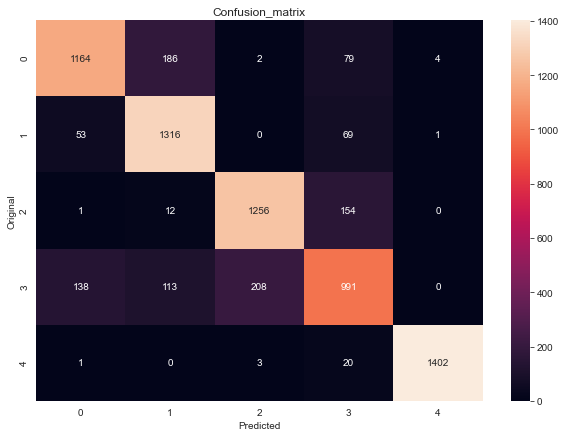

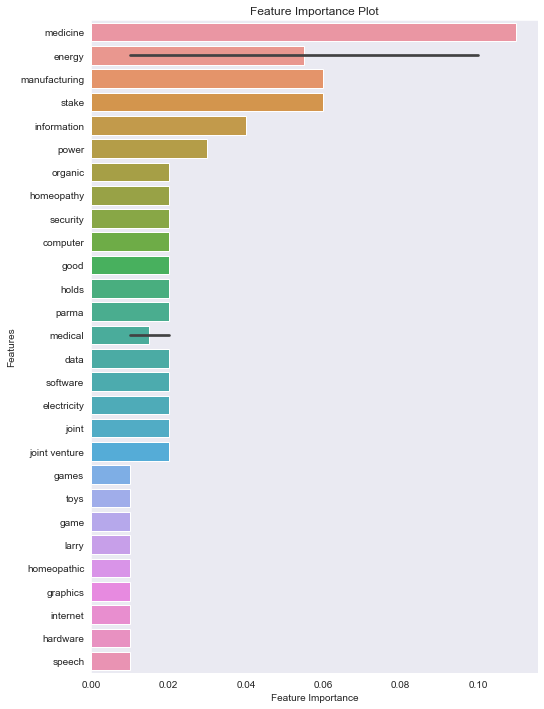

----------------------Feature Importances From Industry Model------------------------

Model For Type

Accuracy: 0.6709884288303359
F1 Score: 0.6678593892069227
Recall: 0.6709884288303359
Precision: 0.6699988056233162
Classification report:               precision    recall  f1-score   support

         0.0       0.54      0.55      0.55       486
         1.0       0.76      0.78      0.77       463
         2.0       0.43      0.43      0.43       418
         3.0       0.69      0.62      0.65       480
         4.0       0.55      0.68      0.60       955
         5.0       0.72      0.72      0.72       309
         6.0       0.77      0.77      0.77       937
         7.0       0.45      0.28      0.34       518
         8.0       0.46      0.45      0.46       288
         9.0       0.50      0.53      0.52       733
        10.0       0.50      0.46      0.48       160
        11.0       0.98      0.97      0.98       864
        12.0       0.97      0.96      0.97       562

 

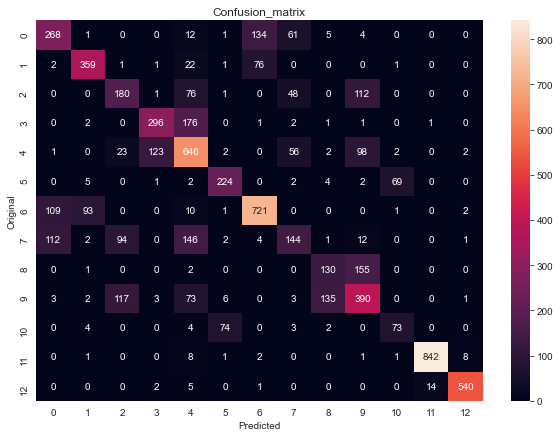

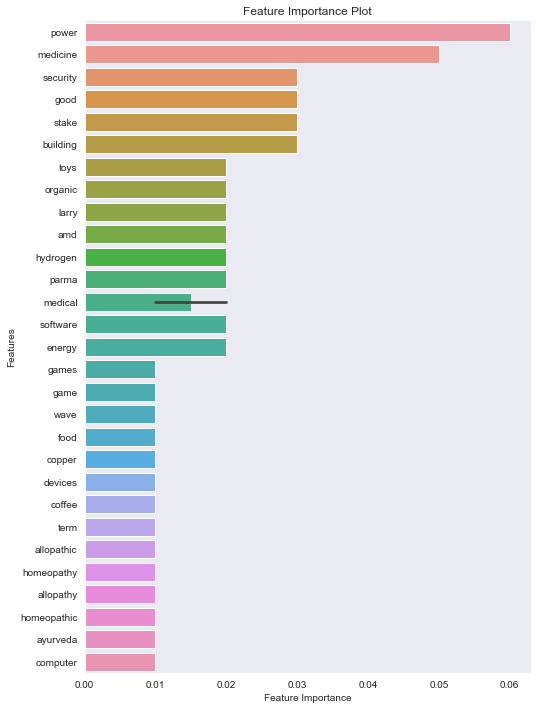

----------------------Feature Importances From Type Model------------------------

Model For Product

Accuracy: 0.8842883033598216
F1 Score: 0.8841445328823229
Recall: 0.8842883033598216
Precision: 0.8852111809042084
Classification report:               precision    recall  f1-score   support

         0.0       0.83      0.91      0.87       523
         1.0       0.70      0.67      0.68       153
         2.0       0.95      0.95      0.95       442
         3.0       0.85      0.83      0.84       200
         4.0       0.71      0.75      0.73       282
         5.0       0.88      0.75      0.81       168
         6.0       0.89      0.94      0.91       282
         7.0       0.88      0.86      0.87       310
         8.0       0.86      0.86      0.86       281
         9.0       0.83      0.88      0.85       280
        10.0       0.76      0.71      0.74       154
        11.0       0.75      0.75      0.75       238
        12.0       0.97      0.95      0.96       309
   

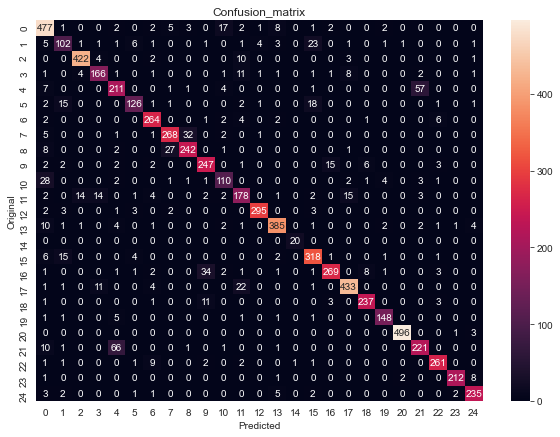

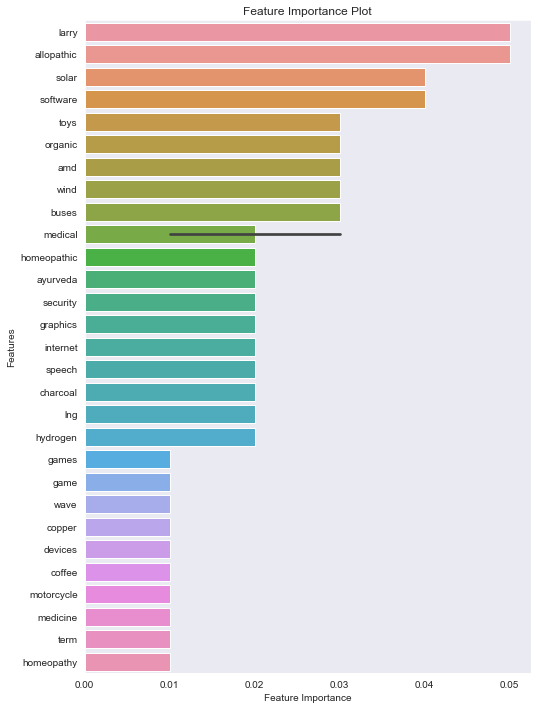

----------------------Feature Importances From Product Model------------------------


In [21]:
run_models(GradientBoostingClassifier(random_state=0),x_train,y_train,x_valid,y_valid)

## Plot Correlation in Features

##### We do see some features are correlated and droping them from training would certaing increase the importance of the remaining features 

## Correlation Matrix

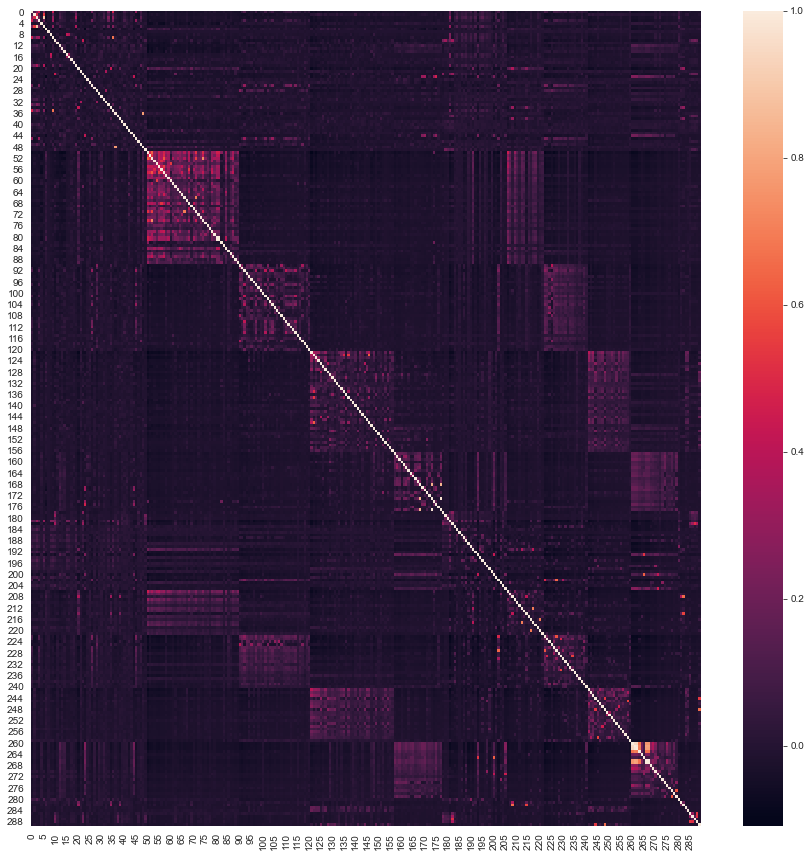

In [22]:
#plt.matshow()
_ = plt.figure(figsize= (15, 15))
_ = sns.heatmap(pd.DataFrame(x_train.toarray()).corr())
plt.show()

## Plot Dendogram to zoom into exact features with high correlation

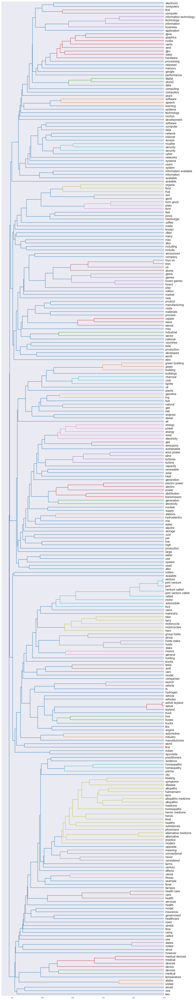

In [23]:
corr = np.round(scipy.stats.spearmanr(pd.DataFrame(x_train.toarray())).correlation, 4) # correlation matrix
corr_condensed = hc.distance.squareform(1-corr)                # distances matrix
z = hc.linkage(corr_condensed, method='average')               # hierarchical/agglomerative clustering

fig = plt.figure(figsize=(16,100))
dendrogram = hc.dendrogram(z, labels = np.concatenate((np.array(prd_inf_vec.get_feature_names()),np.array(comp_bck_vec.get_feature_names())),axis=0) , orientation='left', leaf_font_size=16)
plt.show()

# Predicting on Test Data

## Data Prep

In [24]:
input_df_processed_prd_info.index = input_df_processed_prd_info['ID']
df_train_prd_info = input_df_processed_prd_info
df_valid_prd_info = test_processed_prd_info
df_valid_prd_info.index = test_processed_prd_info.index
input_df_processed_prd_info.index = input_df_processed_background['ID']
df_train_background = input_df_processed_background
df_valid_background = test_processed_background
df_valid_background.index = test_processed_background.index
pred_inf_top_words = get_top_words(input_df_processed_prd_info,2,50,10,'product_info') 
pred_bck_top_words = get_top_words(input_df_processed_background,2,25,10,'Company_background') 
oe_prd_info = OrdinalEncoder()
oe_background = OrdinalEncoder()

def create_model_inputs_test(df_train,df_valid,vocab,encoder,column):
    vectorizer = TfidfVectorizer(min_df= 1,
                                 #max_df =100,
                                 lowercase = True,
                                 vocabulary = vocab['word'].drop_duplicates(),
                                 sublinear_tf = True,
                                 stop_words=stop_words,
                                 ngram_range=(1,10)
                                ) 
    vectorizer.fit(df_train[column].apply(lambda x: np.str_(x)))
    x_train = vectorizer.transform(df_train[column].apply(lambda x: np.str_(x)))
    
    # we need the class labels encoded into integers for functions in the pipeline
    y_train = encoder.fit_transform(df_train[y_columns].values.reshape(-1, 3))
    
    x_valid = vectorizer.transform(df_valid['clean'].apply(lambda x: np.str_(x)))
    #y_valid = oe.fit_transform(df_valid[y_columns].values.reshape(-1, 3))
    
    print('X training shape', x_train.shape, x_train.dtype)
    print('Y training shape', y_train.shape, y_train.dtype)
    print('X validation shape', x_valid.shape, x_valid.dtype)
    
    return x_train,y_train,x_valid,vectorizer
x_train_prd_info,y_train_prd_info,x_valid_prd_info,info_vec = create_model_inputs_test(df_train_prd_info,df_valid_prd_info,pred_inf_top_words,oe_prd_info,'product_info')
x_train_background,y_train_background,x_valid_background,bck_vec = create_model_inputs_test(df_train_background,df_valid_background,pred_bck_top_words,oe_background,'Company_background')
x_train = hstack((x_train_prd_info, x_train_background,train_x_sparse))
x_valid = hstack((x_valid_prd_info, x_valid_background,test_x_sparse))
y_train = y_train_prd_info

X training shape (23909, 180) float64
Y training shape (23909, 3) float64
X validation shape (15890, 180) float64
X training shape (23909, 108) float64
Y training shape (23909, 3) float64
X validation shape (15890, 108) float64


## Final Results Exported (Training Model on Full Data and Exporting Results)

In [26]:
clf=MultiOutputClassifier(LogisticRegression(solver = 'liblinear'))
clf.fit(x_train, y_train)

MultiOutputClassifier(estimator=LogisticRegression(C=1.0, class_weight=None,
                                                   dual=False,
                                                   fit_intercept=True,
                                                   intercept_scaling=1,
                                                   l1_ratio=None, max_iter=100,
                                                   multi_class='auto',
                                                   n_jobs=None, penalty='l2',
                                                   random_state=None,
                                                   solver='liblinear',
                                                   tol=0.0001, verbose=0,
                                                   warm_start=False),
                      n_jobs=None)

In [27]:
y_pred_probas = clf.predict_proba(x_valid)
y_pred = clf.predict(x_valid)
predictions = pd.DataFrame(oe_prd_info.inverse_transform(y_pred),columns = ['Industry','Type','Product'])
predictions.index = test_processed_prd_info['ID']
predictions=predictions.reindex(columns=['Industry','Type','Product'])
#predictions_probas = pd.DataFrame(y_pred_probas,columns = ['Industry','Type','Product'])
#predictions_probas['mean'] = (predictions_probas['Industry'] + predictions_probas['Type'] + predictions_probas['Product'])/3
#predictions_probas.to_csv('probas.csv')
predictions.to_csv('Shantanu_Jha_17200_predictions.csv',index = True)
prd_info_cols = np.array(info_vec.get_feature_names())
comp_back_cols = np.array(bck_vec.get_feature_names())
vectorized_cols = np.concatenate((prd_info_cols,comp_back_cols),axis=0)
all_feature_columns = np.concatenate((vectorized_cols,test_column_list),axis =0)


In [28]:
try:
    print('Feature Importances From Industry Model')
    importances = list(clf.estimators_[0].feature_importances_)
    feature_importances = [(feature, round(importance, 2)) for feature, importance in zip(all_feature_columns, importances)]
    feature_importances = sorted(feature_importances, key = lambda x: x[1], reverse = True)
    feature_importances = feature_importances[:30]
    fig, ax = plt.subplots(1, 1, figsize=(8, 12))
    sns.barplot(y=pd.DataFrame(feature_importances)[0], x=pd.DataFrame(feature_importances)[1], ax=ax);
    ax.set_xlabel('Feature Importance')
    ax.set_ylabel('Features')
    ax.set_title('Feature Importance Plot')
    plt.show()
except:
    pass

Feature Importances From Industry Model


In [29]:
try:
    print('Feature Importances From Type Model')
    importances = list(clf.estimators_[1].feature_importances_)
    feature_importances = [(feature, round(importance, 2)) for feature, importance in zip(all_feature_columns, importances)]
    feature_importances = sorted(feature_importances, key = lambda x: x[1], reverse = True)
    feature_importances = feature_importances[:30]
    fig, ax = plt.subplots(1, 1, figsize=(8, 12))
    sns.barplot(y=pd.DataFrame(feature_importances)[0], x=pd.DataFrame(feature_importances)[1], ax=ax);
    ax.set_xlabel('Feature Importance')
    ax.set_ylabel('Features')
    ax.set_title('Feature Importance Plot')
    plt.show()
except:
    pass

Feature Importances From Type Model


In [30]:
try:
    print('Feature Importances From Product Model')
    importances = list(clf.estimators_[2].feature_importances_)
    feature_importances = [(feature, round(importance, 2)) for feature, importance in zip(all_feature_columns, importances)]
    feature_importances = sorted(feature_importances, key = lambda x: x[1], reverse = True)
    feature_importances = feature_importances[:30]
    fig, ax = plt.subplots(1, 1, figsize=(8, 12))
    sns.barplot(y=pd.DataFrame(feature_importances)[0], x=pd.DataFrame(feature_importances)[1], ax=ax);
    ax.set_xlabel('Feature Importance')
    ax.set_ylabel('Features')
    ax.set_title('Feature Importance Plot')
    plt.show();
except:
    pass

Feature Importances From Product Model
